In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import requests
import scipy
from scipy.optimize import curve_fit
import random

## Indicator: SP.POP.TOTL

In [31]:
seed = 'http://api.worldbank.org/v2/country/all/indicator/SP.POP.TOTL?format=json'
#seed = 'http://api.worldbank.org/v2/country/all/indicator/SH.HIV.0014;SH.DYN.MORT?source=2&format=json'
response_seed = requests.get(seed).json()
df = pd.DataFrame.from_dict(response_seed[1])

In [32]:
# response_seed

In [ ]:
%%time
for page in range(2, response_seed[0]['pages']+1): 
#for page in range(2, 50): 
    url = 'http://api.worldbank.org/v2/country/all/indicator/SP.POP.TOTL?page='+str(page)+'&format=json'
    response = requests.get(url).json()
    df = df.append(pd.DataFrame.from_dict(response[1]), ignore_index=True)
    print(page)

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223


In [15]:
df.to_csv('data/df.csv', index=False)

In [10]:
df['date'] = df['date'].astype(float)

In [11]:
df.shape

(16200, 8)

In [12]:
# Countries
df_group = df.groupby(['countryiso3code', 'date'])['value'].sum().copy()

countries = df_group.index.get_level_values(0).unique()
print('No. Total countries: ', len(countries))

print('Min. date: ', df['date'].min(), ' year')

No. Total countries:  261
Min. date:  1960.0  year


In [14]:
df_group.to_csv('data/df_group.csv', index=True)

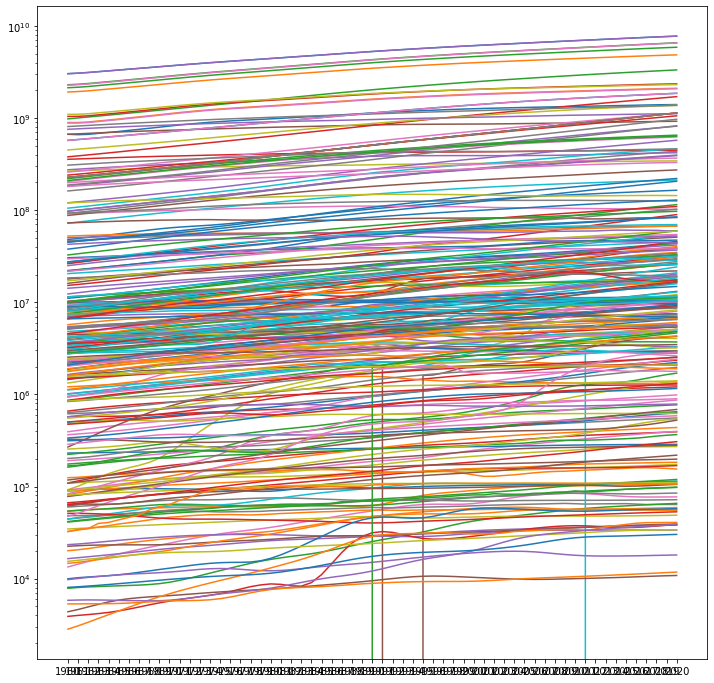

In [9]:
plt.figure(figsize=(12, 12))
for country in countries:
    plt.plot(df_group[country])
plt.yscale("log")
plt.show()

In this basis analysis and log plot, there is a lot of lines: almost all is a exponential behaviour. 

So, we going to model almost all using exp(t) using 
1. all the avialable data
2. last 10 years 
and explore the R2: how good to the model it is. 

It is possible:

3. normalize the data using «total area» per country 
4. Correlations in time with «money», «fertiluty» and «migrations»

## 1. Explore the Exp(t) model

[0.04661726]


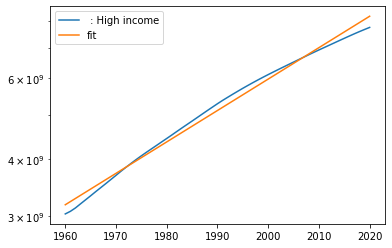

[0.37095472]


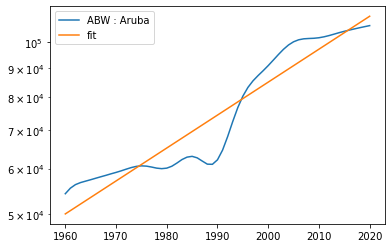

[0.00247299]


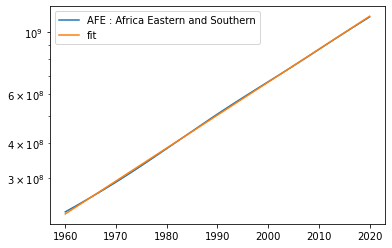

[0.96171307]


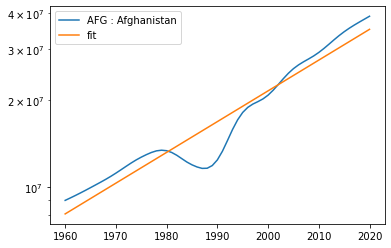

[0.17027351]


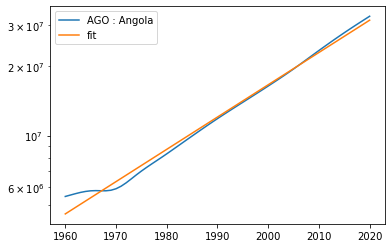

[0.96479898]


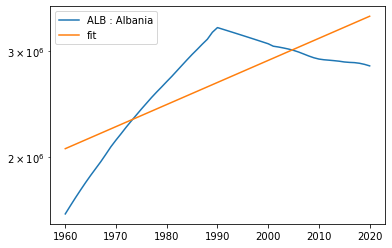

[1.48974578]


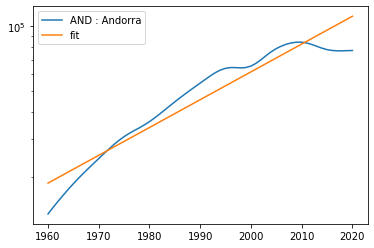

[0.06197127]


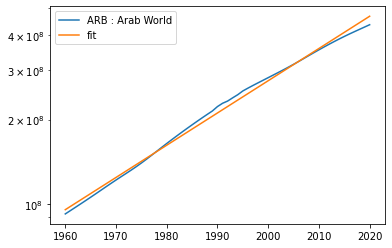

[3.93302948]


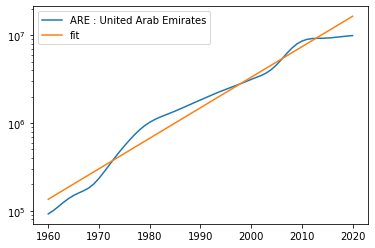

[0.02777758]


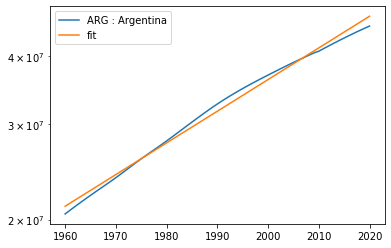

[0.95072126]


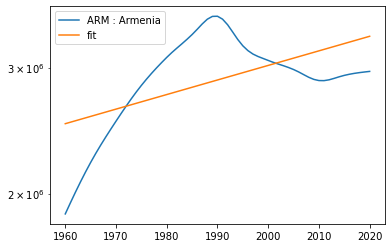

[0.87151937]


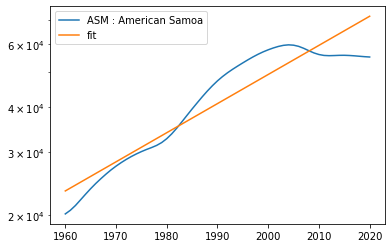

[0.22636062]


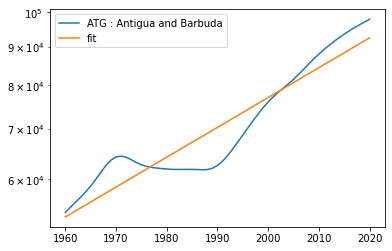

[0.02253195]


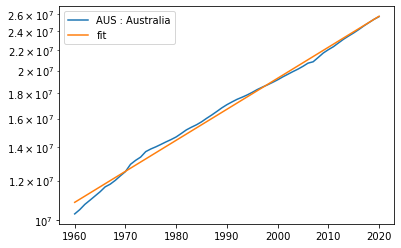

[0.01216451]


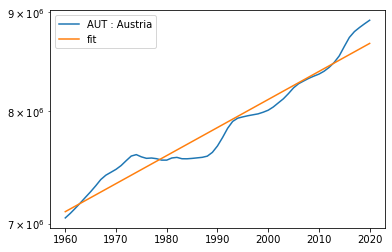

[0.09888712]


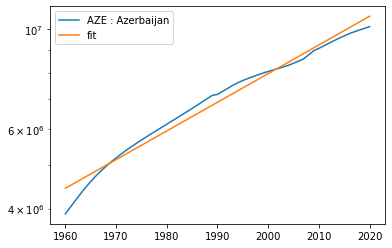

[0.08377232]


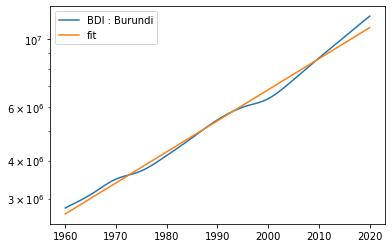

[0.01677384]


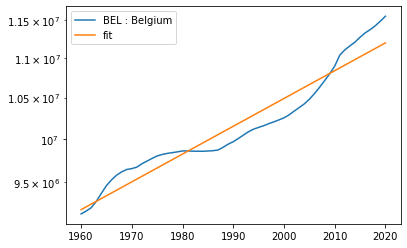

[0.06226763]


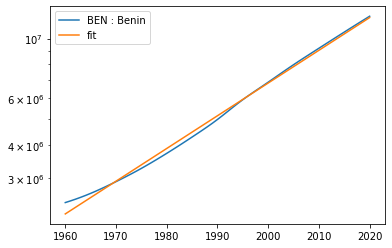

[0.11590332]


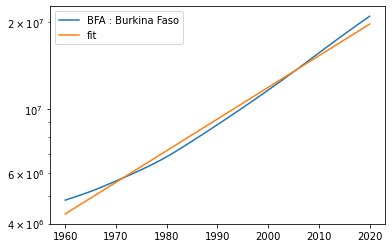

[0.13366621]


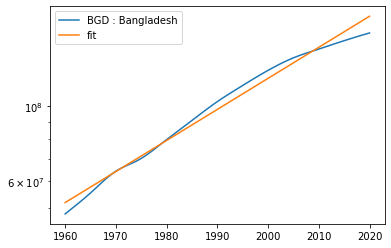

[0.19278223]


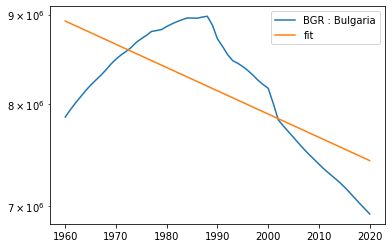

[0.21961402]


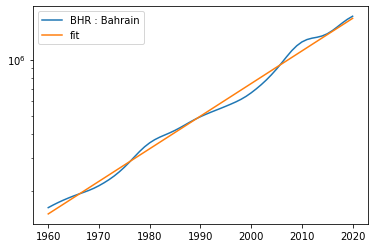

[0.24234687]


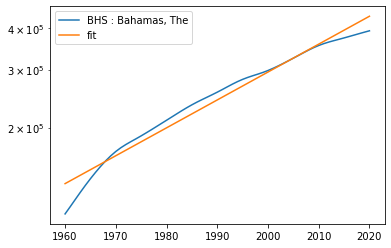

[0.48242217]


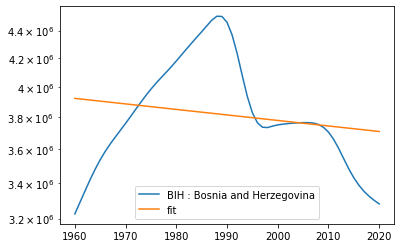

[0.13958475]


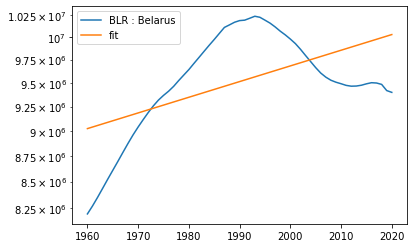

[0.04338783]


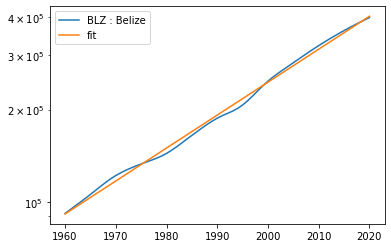

[0.05582654]


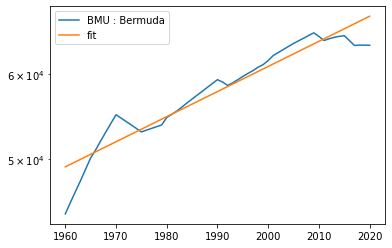

[0.01925727]


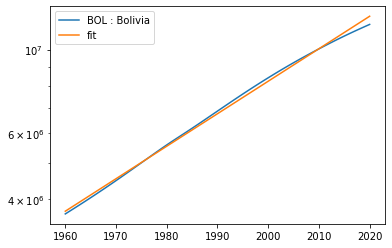

[0.19830012]


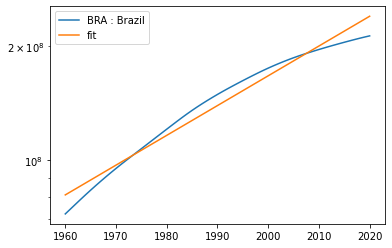

[0.00182103]


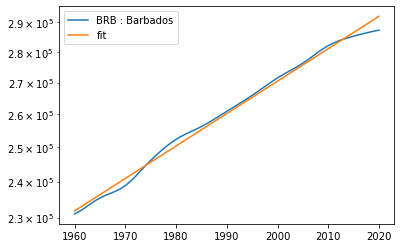

[0.65110952]


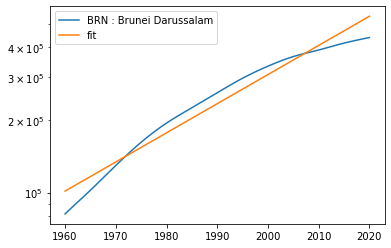

[0.32059975]


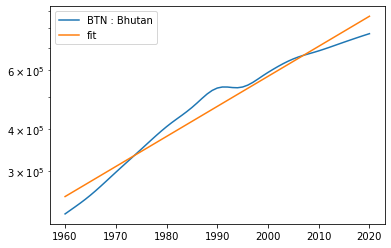

[0.25865272]


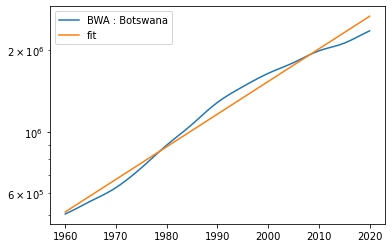

[0.08565046]


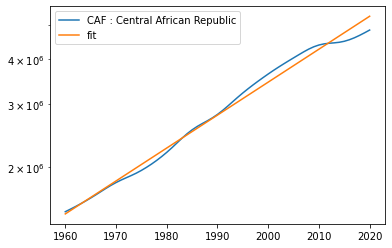

[0.02342861]


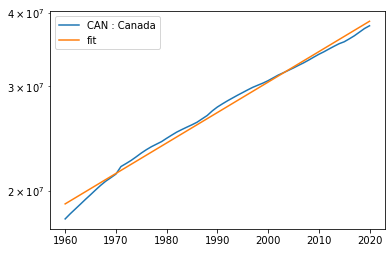

[0.11501144]


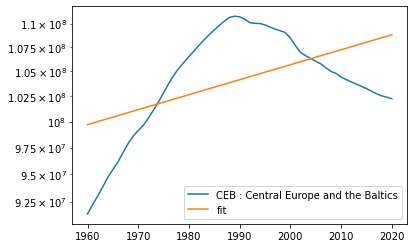

[0.02610755]


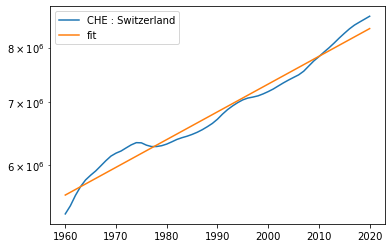

[0.0058519]


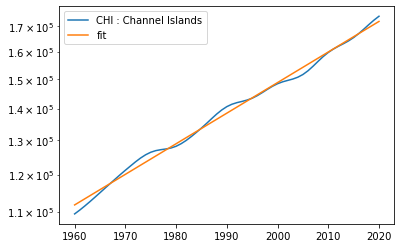

[0.02589498]


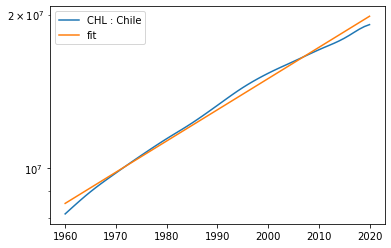

[0.19994968]


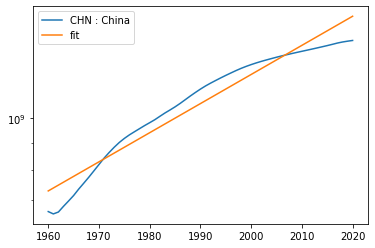

[0.36422547]


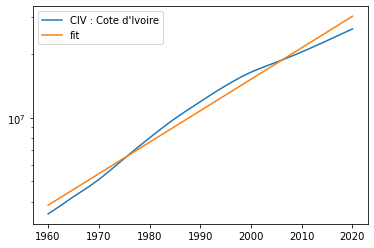

[0.01150266]


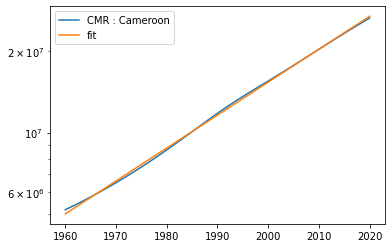

[0.02250006]


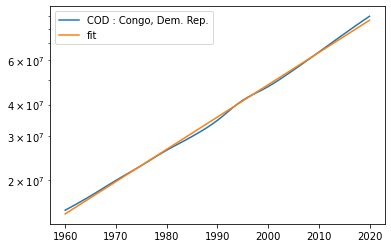

[0.00330587]


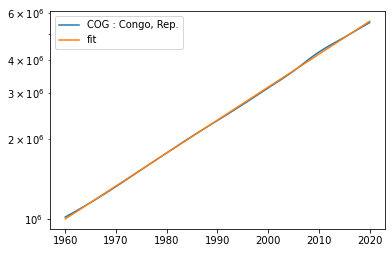

[0.13085651]


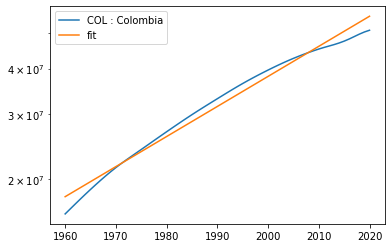

[0.03701371]


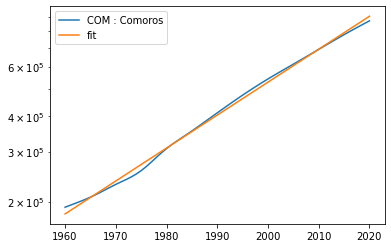

[0.06563324]


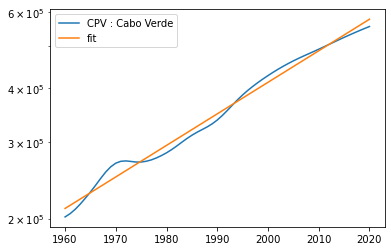

[0.19657256]


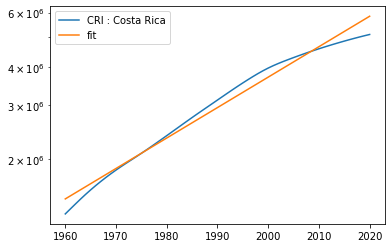

[0.03259131]


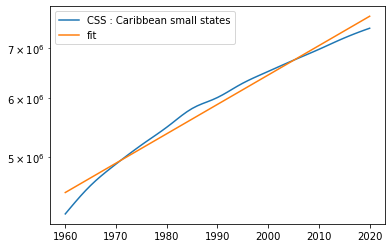

[0.16222802]


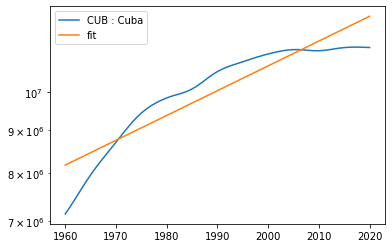

[0.17087874]


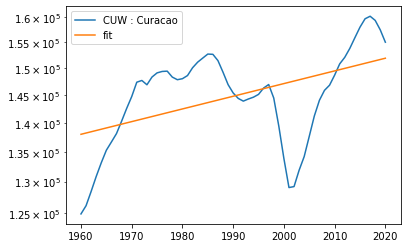

[0.53876009]


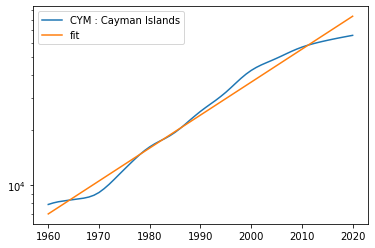

[0.07292708]


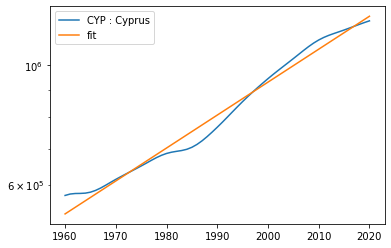

[0.0103987]


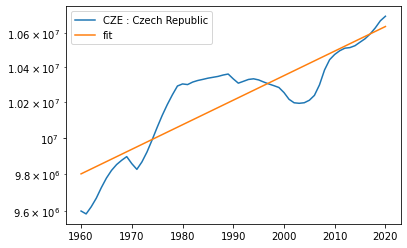

[0.01370843]


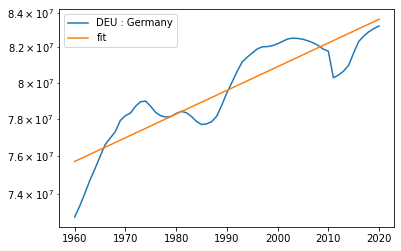

[3.06458735]


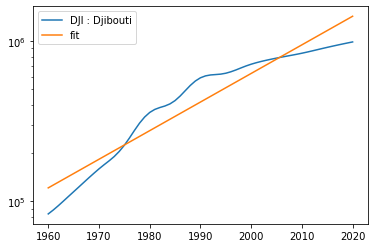

[0.11157721]


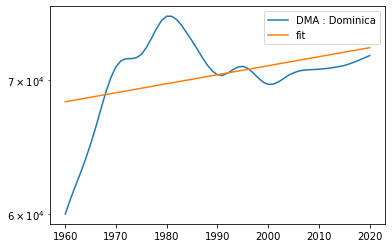

[0.00960896]


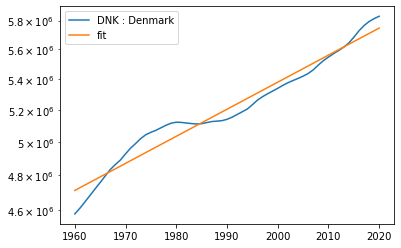

[0.18547055]


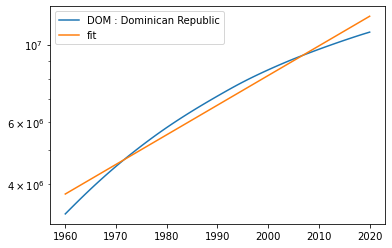

[0.17483545]


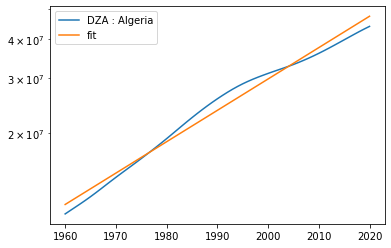

[0.17791263]


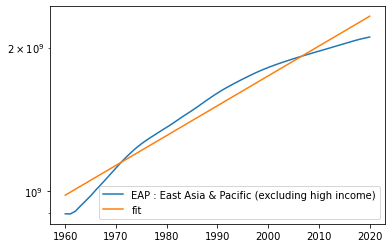

[0.08241653]


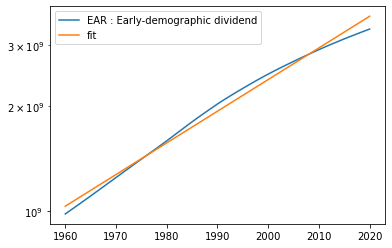

[0.16524498]


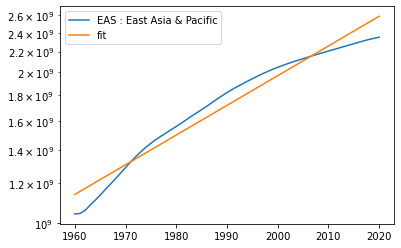

[0.09072317]


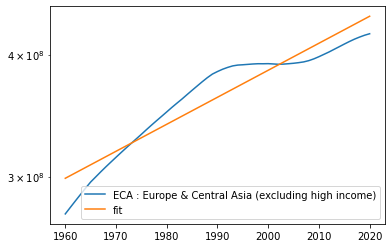

[0.02818914]


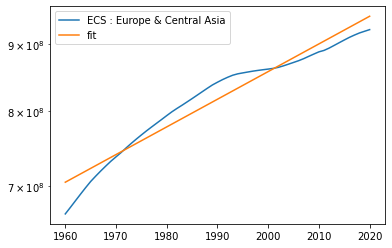

[0.11660332]


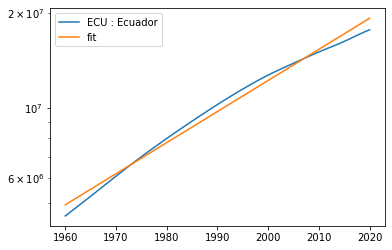

[0.02722901]


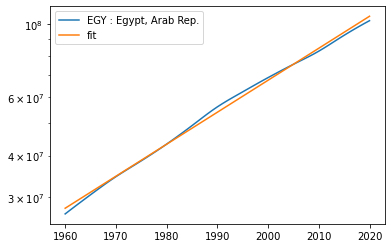

[0.00748612]


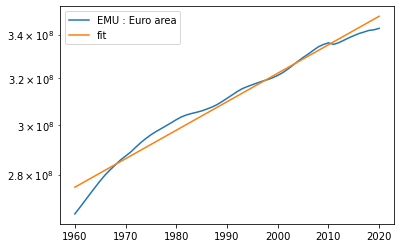

[0.0288574]


<ipython-input-98-8f317125e4ff>:10: RuntimeWarning: divide by zero encountered in log
  parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)


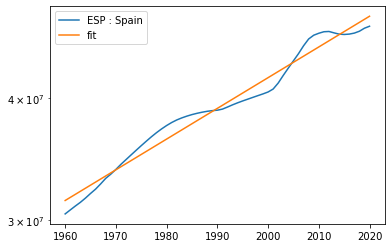

[0.25930004]


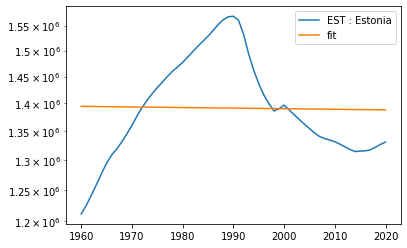

[0.04600147]


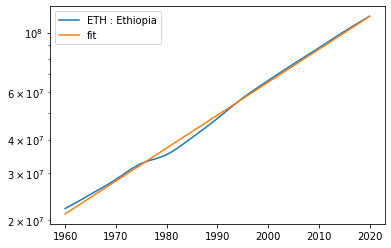

[0.01588333]


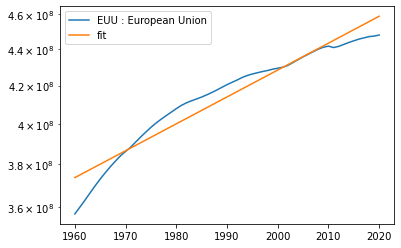

[0.00263186]


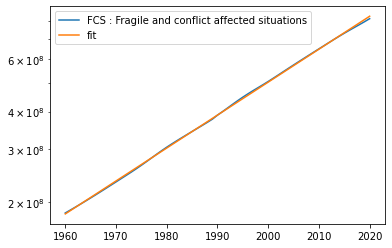

[0.00081225]


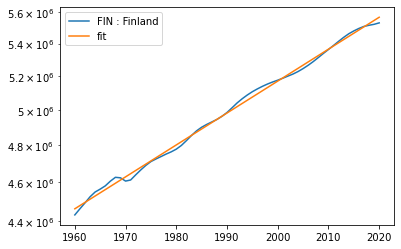

[0.28520482]


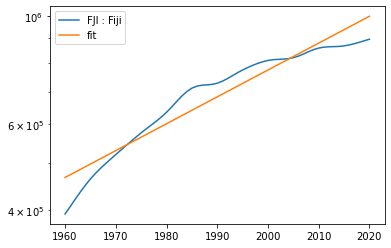

[0.00826445]


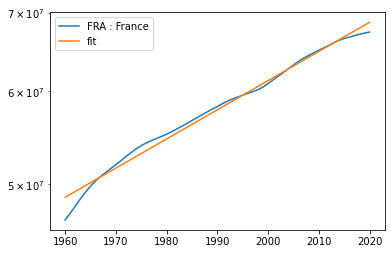

[0.09851403]


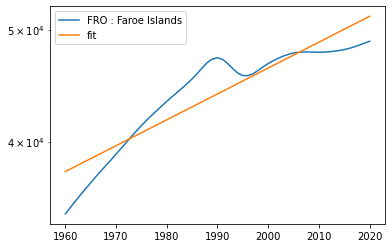

[0.65145775]


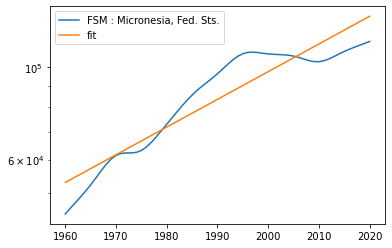

[0.08535309]


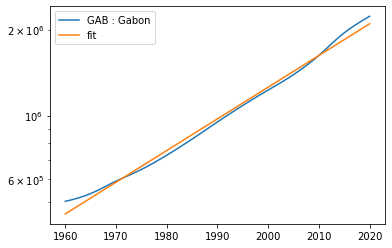

[0.02172531]


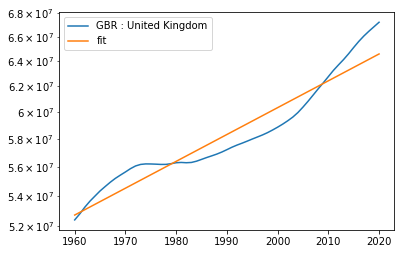

[0.47254721]


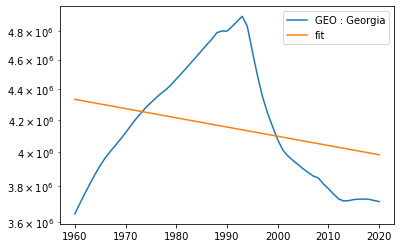

[0.00879802]


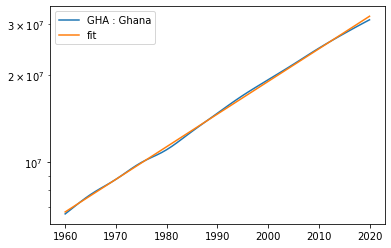

[0.11603785]


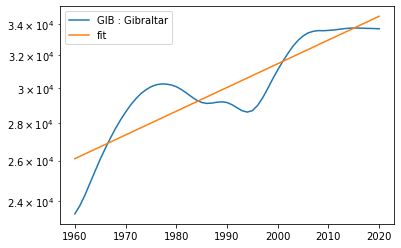

[0.05554003]


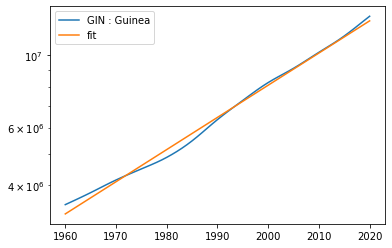

[0.0529667]


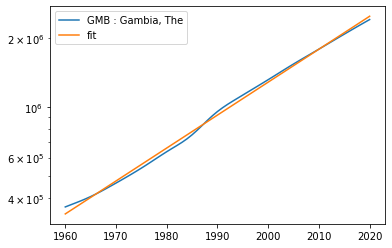

[0.1126452]


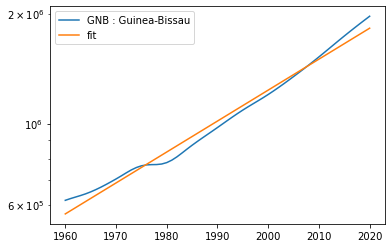

[1.7607314]


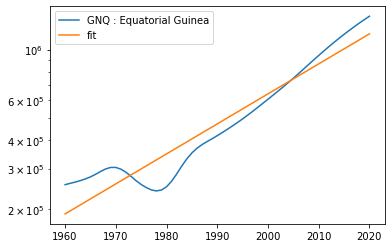

[0.05533575]


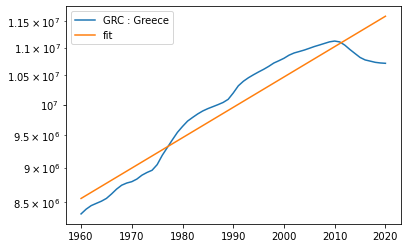

[0.04193064]


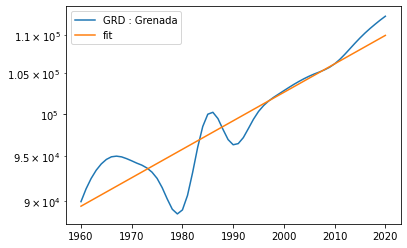

[0.3898065]


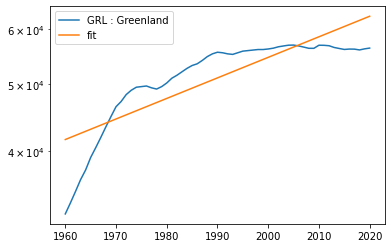

[0.04075558]


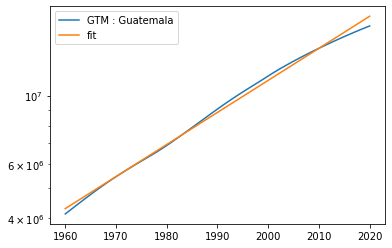

[0.34619007]


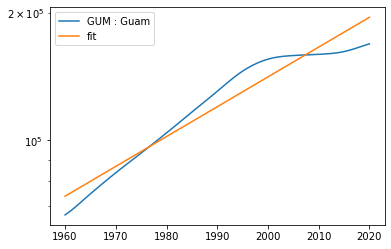

[0.16887061]


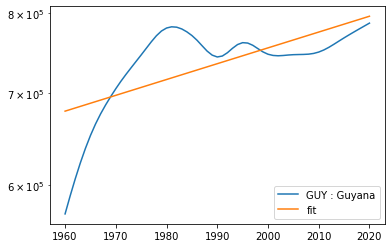

[0.22731101]


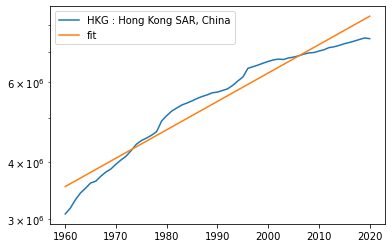

[0.07188723]


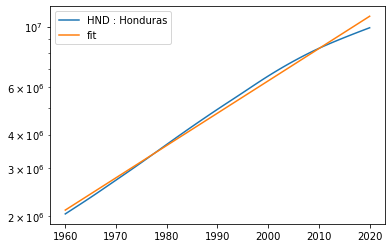

[0.00524794]


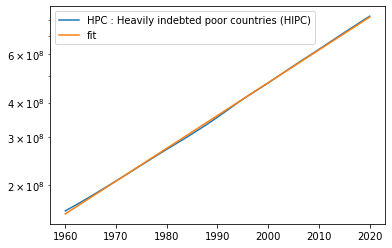

[0.11098681]


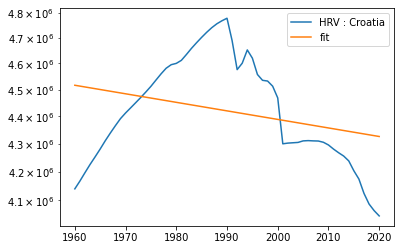

[0.02440039]


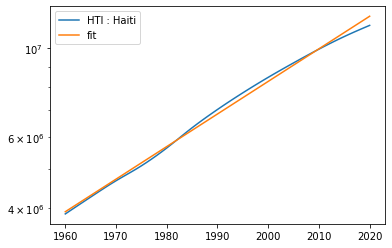

[0.03244313]


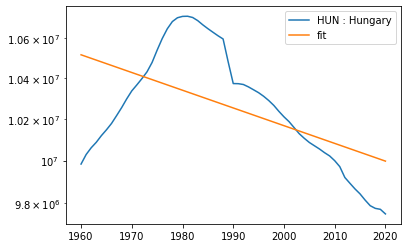

[0.1080879]


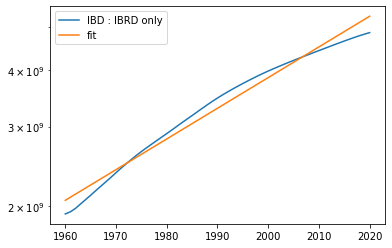

[0.06986221]


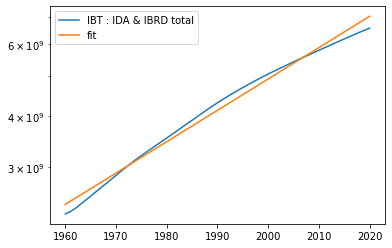

[0.0110335]


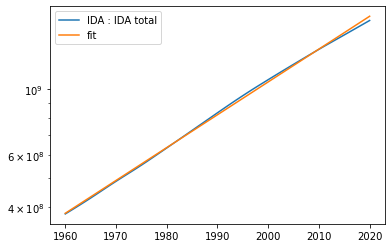

[0.02764405]


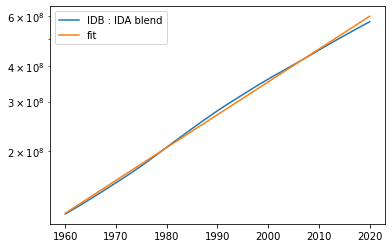

[0.15241228]


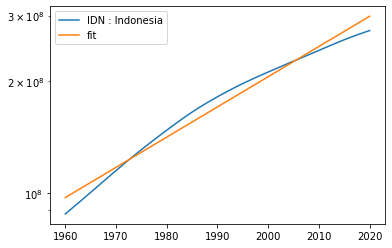

[0.00684599]


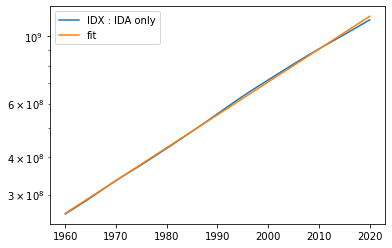

[0.06535023]


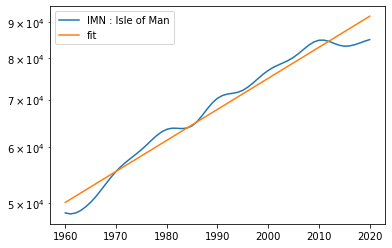

[0.07047772]


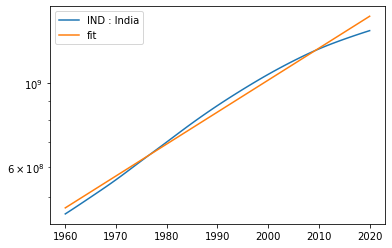

[0.05504603]


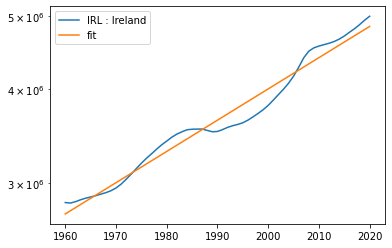

[0.46569678]


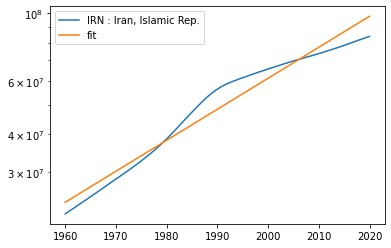

[0.02424077]


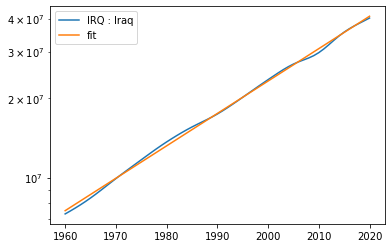

[0.00948482]


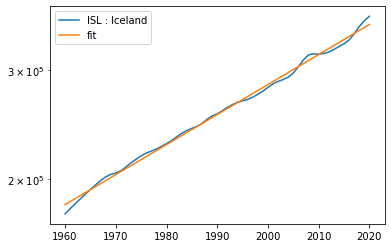

[0.06738663]


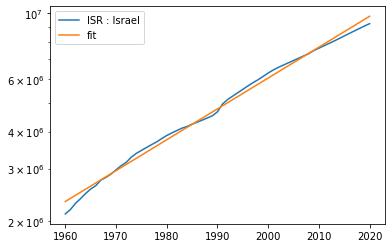

[0.01578032]


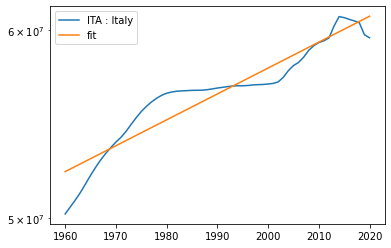

[0.06724354]


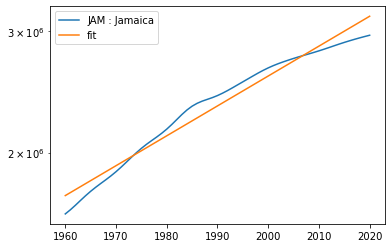

[0.25488256]


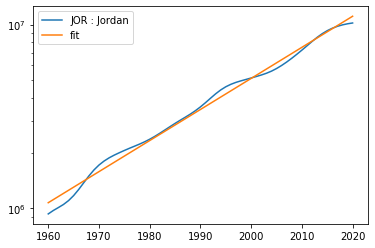

[0.11853633]


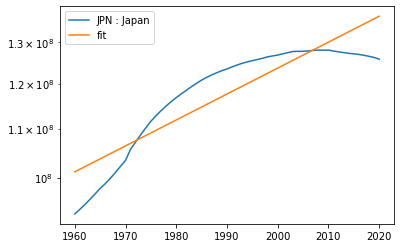

[0.29857807]


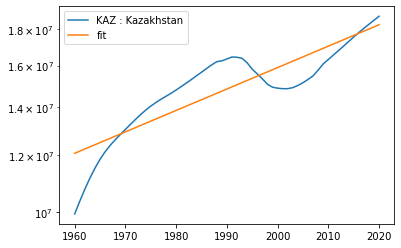

[0.10652149]


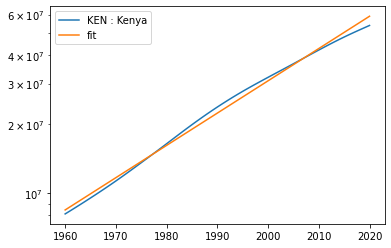

[0.13716959]


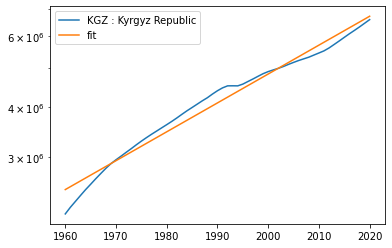

[0.32142839]


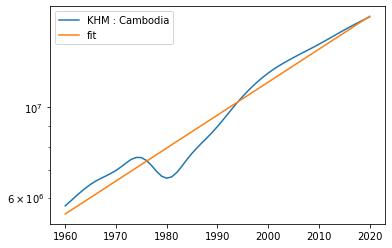

[0.00799635]


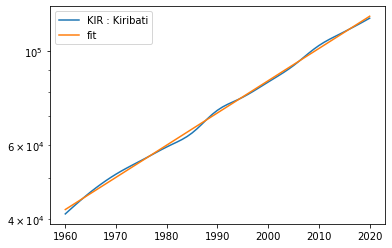

[0.37915071]


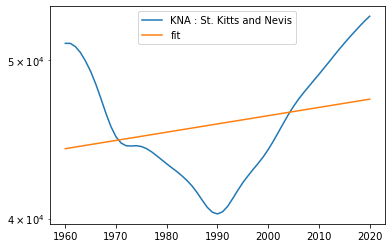

[0.183467]


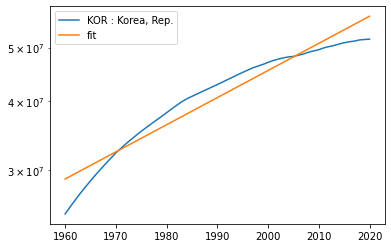

[0.14890888]


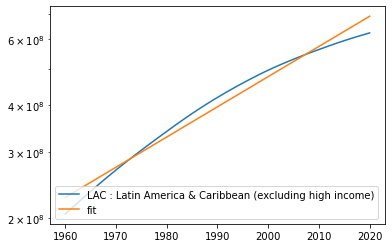

[0.05854383]


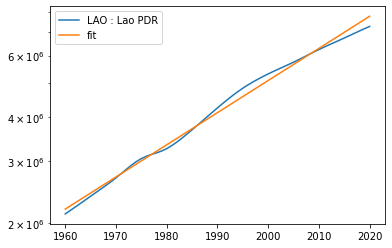

[0.43524963]


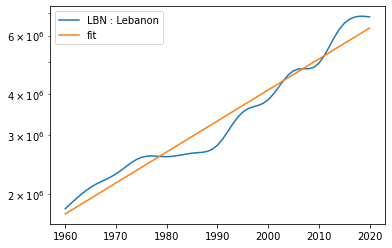

[0.35926988]


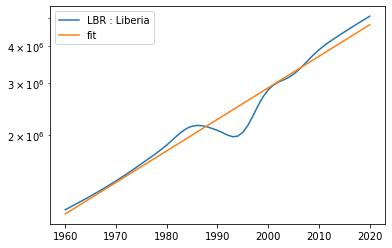

[0.78789668]


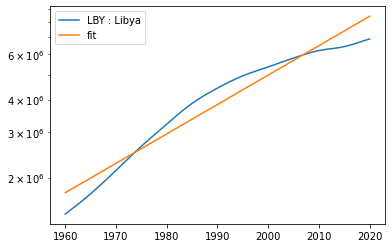

[0.03048661]


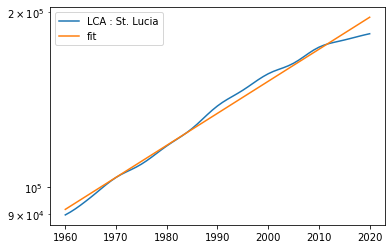

[0.13950872]


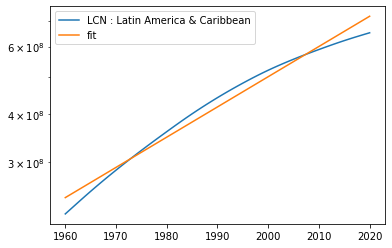

[0.00322584]


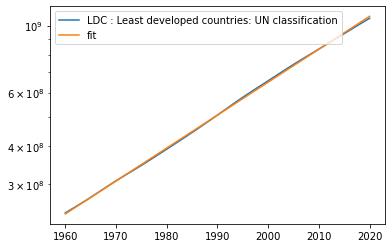

[0.14295195]


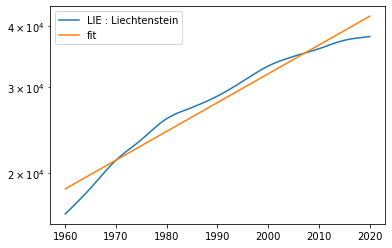

[0.16582594]


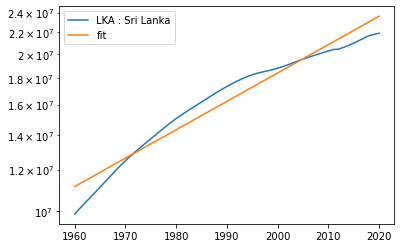

[0.07149482]


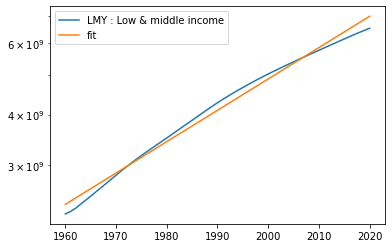

[0.51708897]


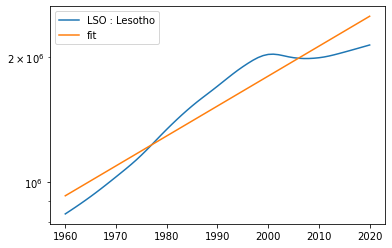

[0.15400272]


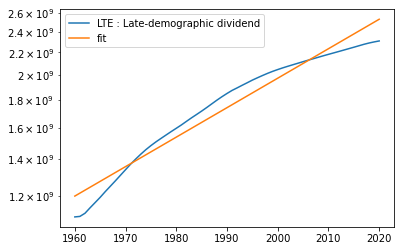

[0.4853689]


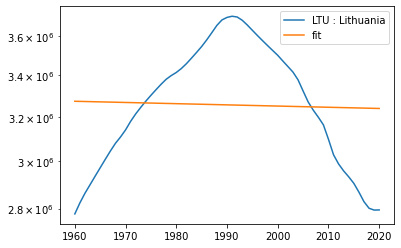

[0.15642119]


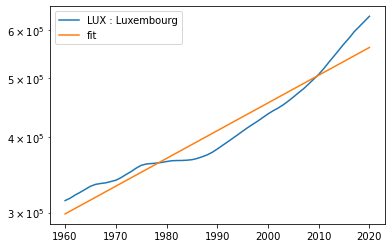

[0.41757322]


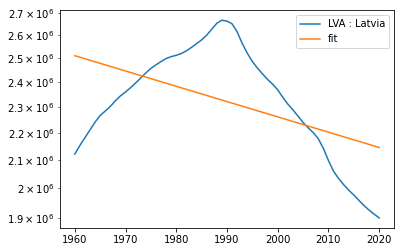

[0.20493773]


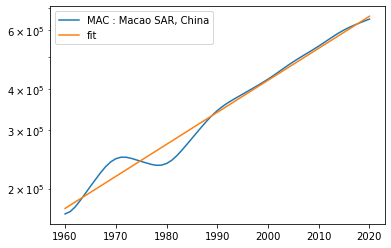

[4.62607259]


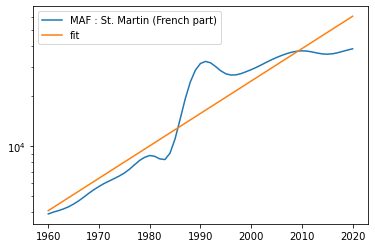

[0.12931292]


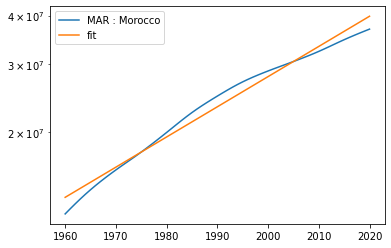

[0.01186411]


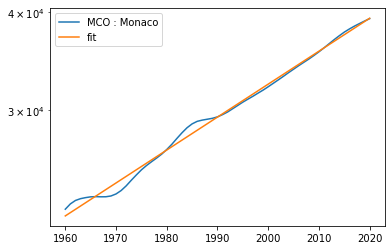

[0.28924586]


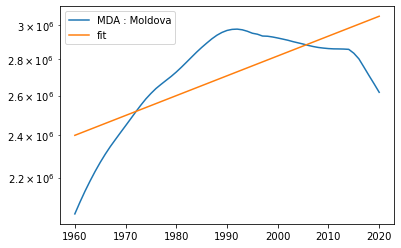

[0.00700897]


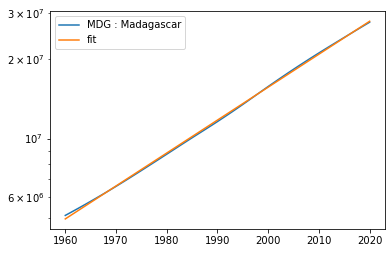

[0.05572591]


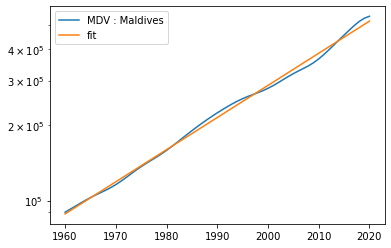

[0.1087557]


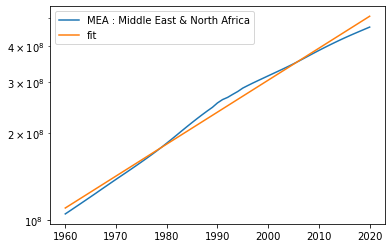

[0.20924795]


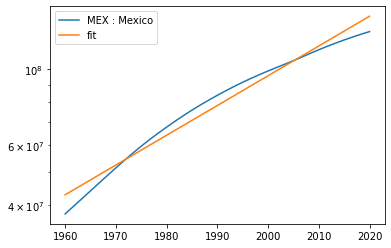

[1.28445714]


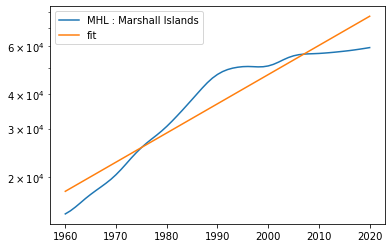

[0.09149752]


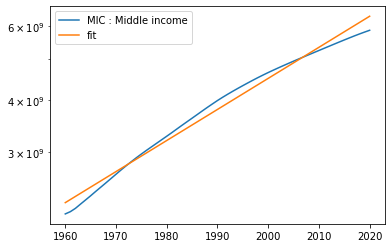

[0.11125866]


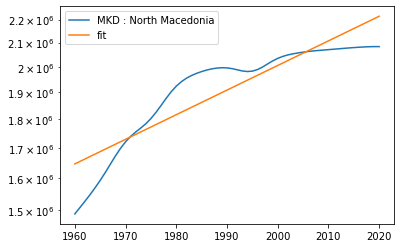

[0.22181676]


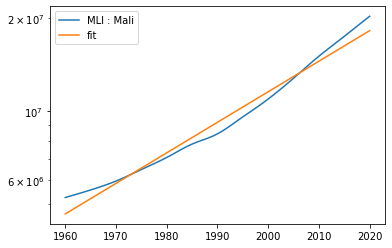

[0.15039746]


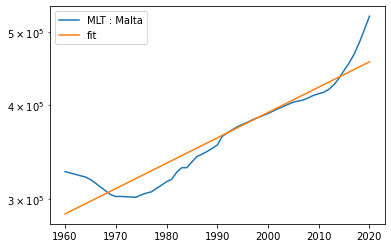

[0.21019871]


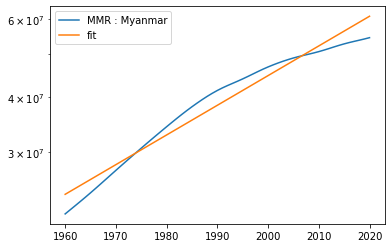

[0.1195767]


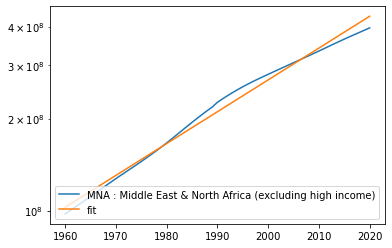

[0.06649849]


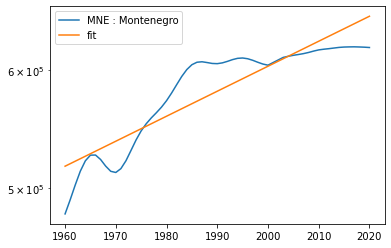

[0.26754464]


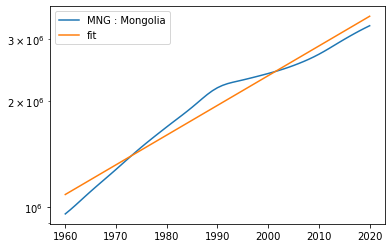

[3.19762947]


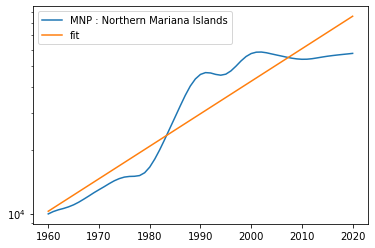

[0.08666348]


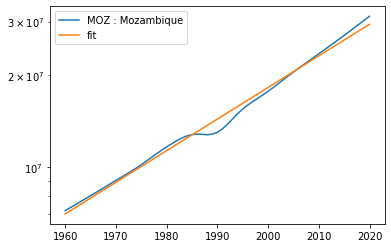

[0.00709884]


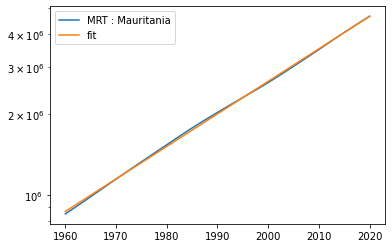

[0.13859594]


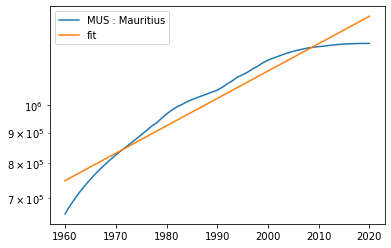

[0.06855669]


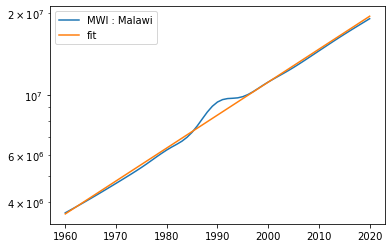

[0.0679473]


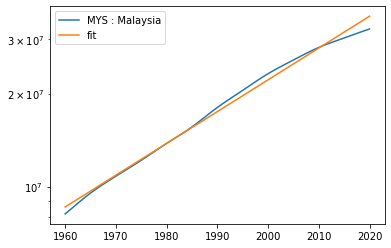

[0.00636509]


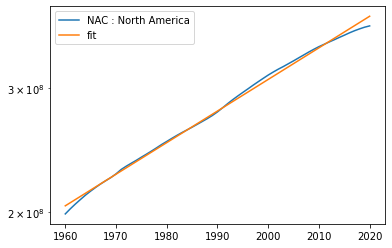

[0.10368518]


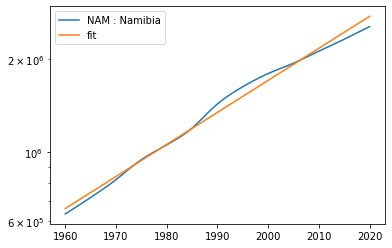

[0.22081979]


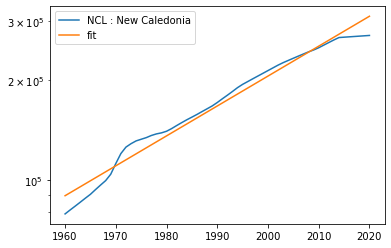

[0.0902204]


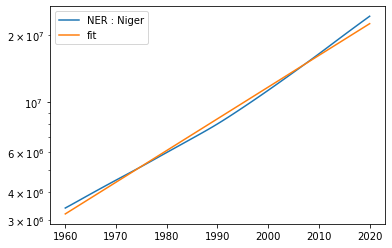

[0.00469992]


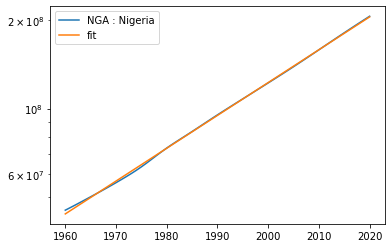

[0.25677895]


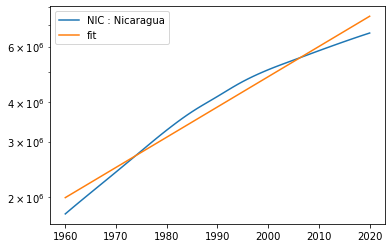

[0.02412244]


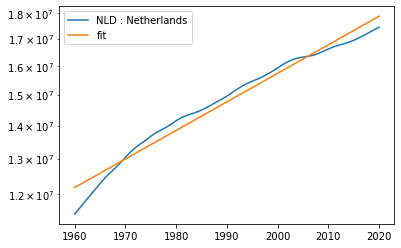

[0.02085216]


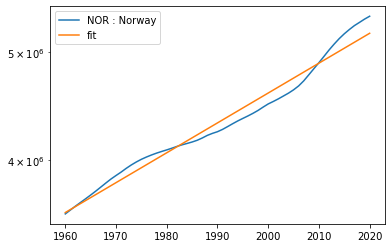

[0.16398885]


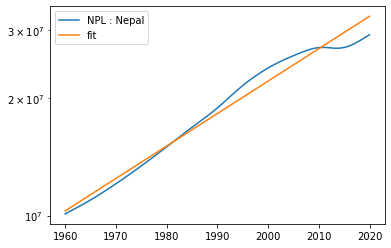

[0.61250891]


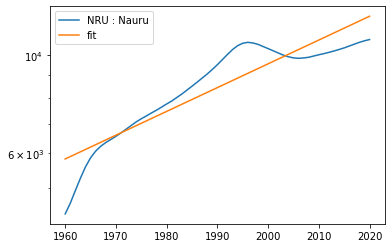

[0.026213]


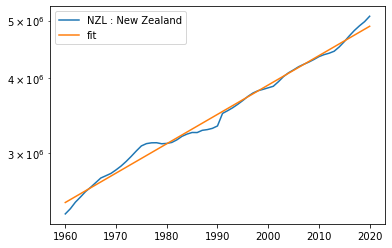

[0.01518599]


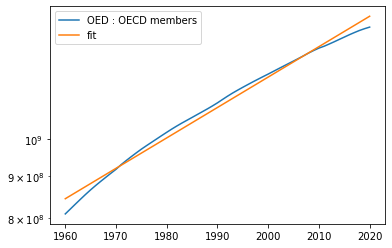

[0.38482228]


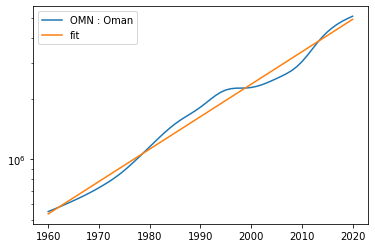

[0.00802826]


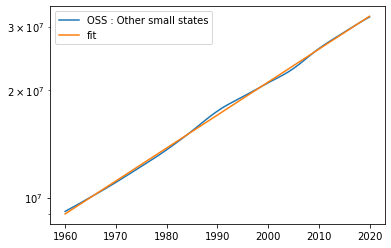

[0.05644976]


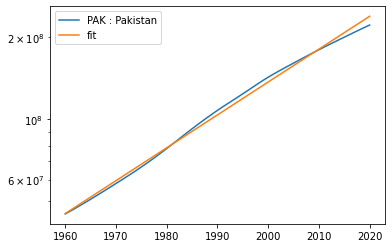

[0.07764213]


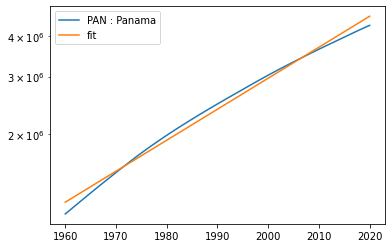

[0.25087451]


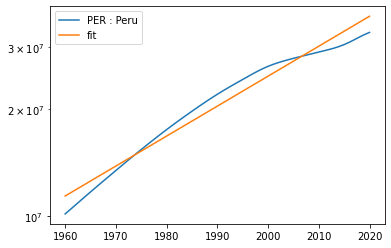

[0.11479208]


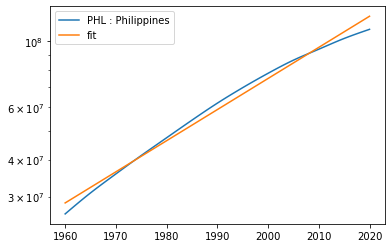

[0.38194308]


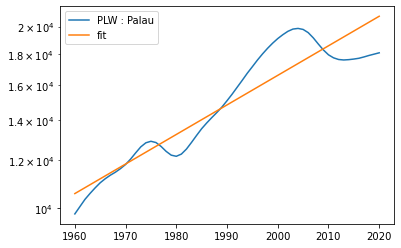

[0.01056737]


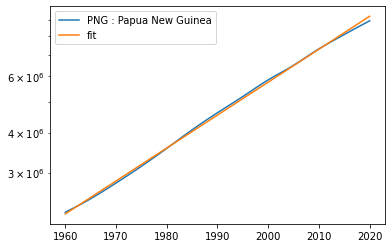

[0.09803204]


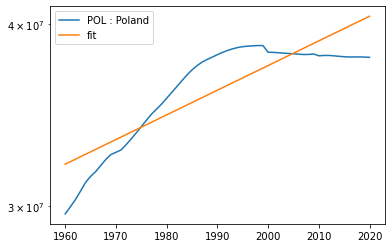

[0.00402216]


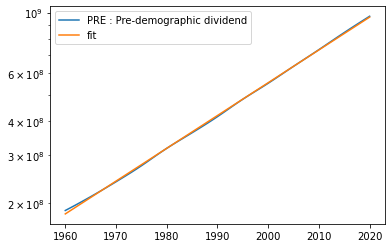

[0.43807269]


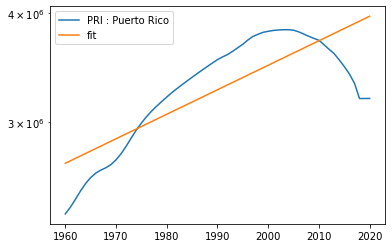

[0.20490219]


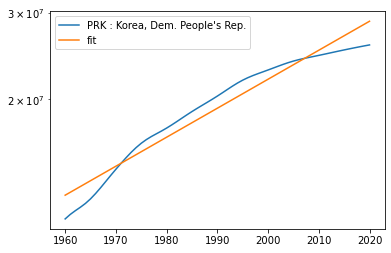

[0.05223872]


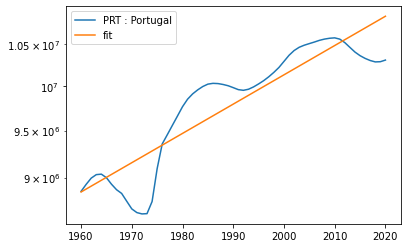

[0.12829906]


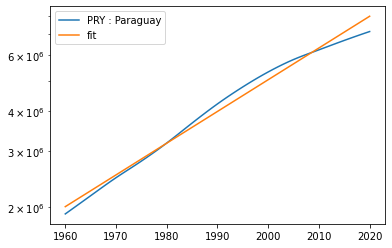

[0.12262891]


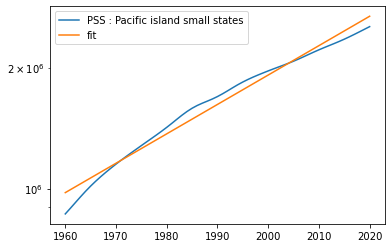

[0.01486008]


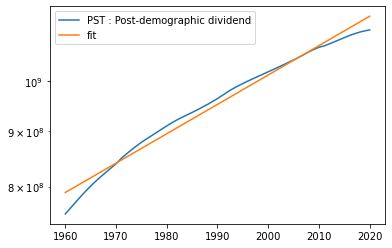

[0.55231462]


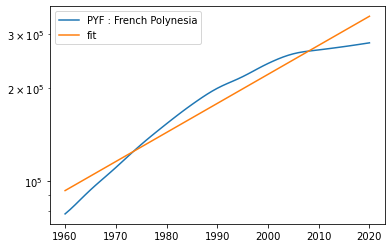

[1.63295534]


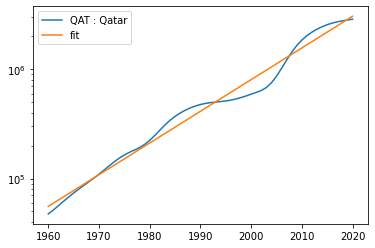

[0.28171879]


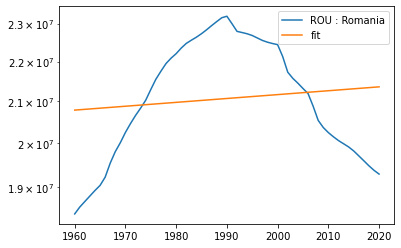

[0.07980814]


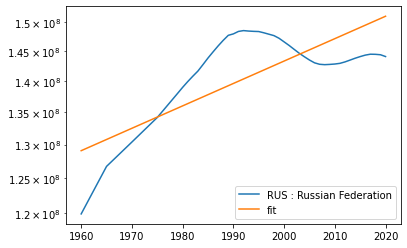

[0.32028269]


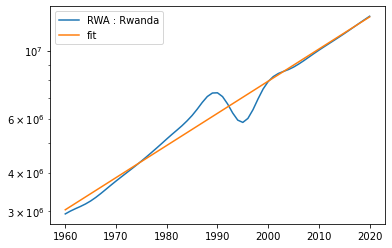

[0.06300497]


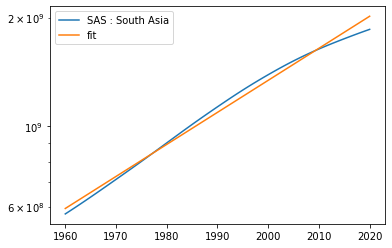

[0.62831076]


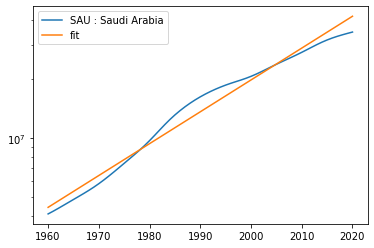

[0.10285589]


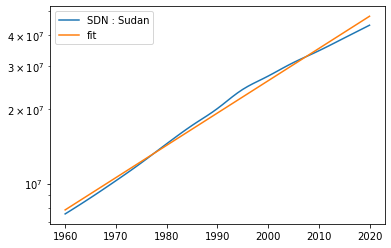

[0.00720032]


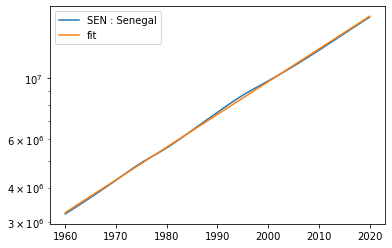

[0.05670066]


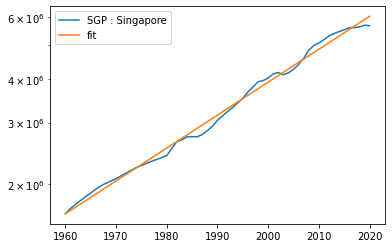

[0.07554021]


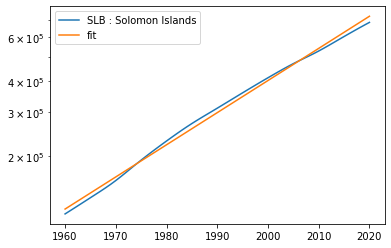

[0.09933544]


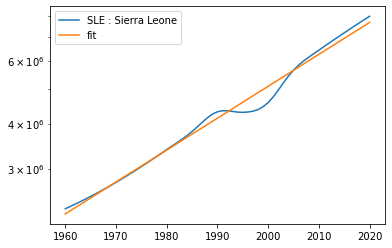

[0.32048103]


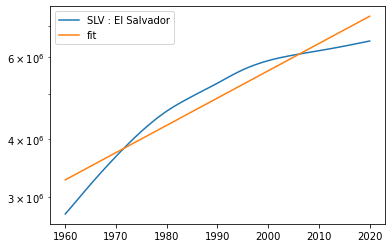

[0.01679596]


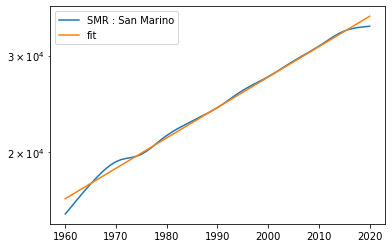

[0.45814504]


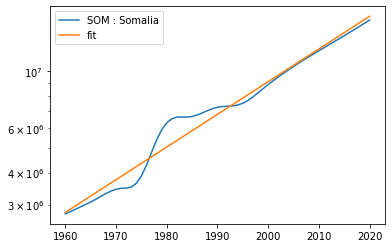

[0.08773742]


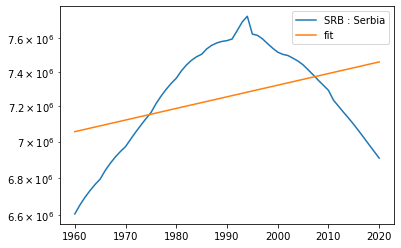

[0.00247633]


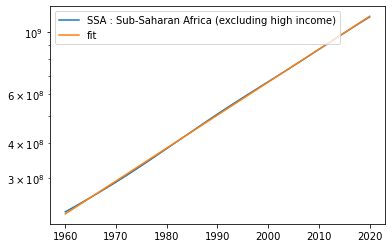

[0.33922669]


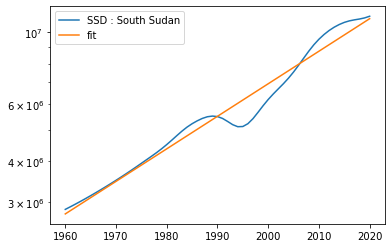

[0.00247299]


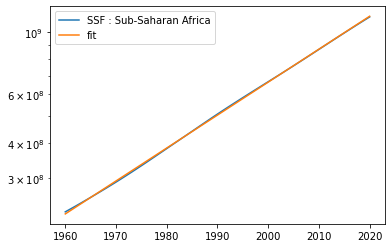

[0.0054219]


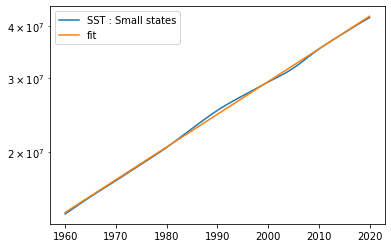

[0.02332484]


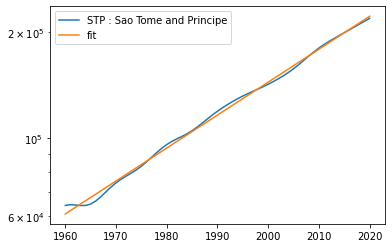

[0.09232126]


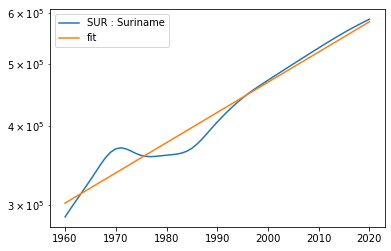

[0.07361289]


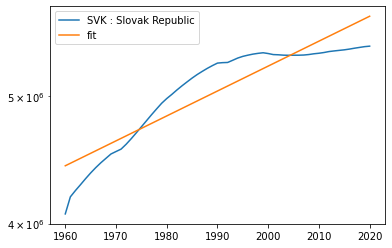

[0.05731385]


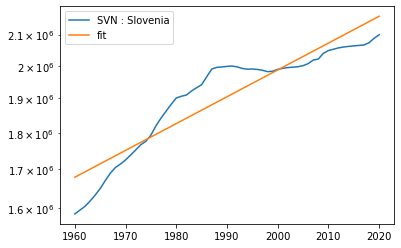

[0.01595844]


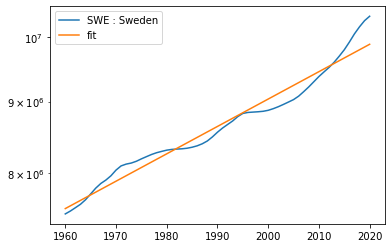

[0.58852859]


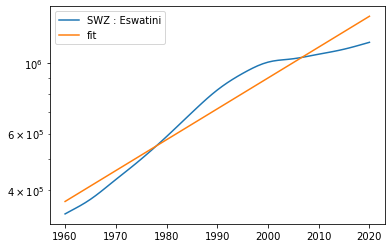

[4.87606364]


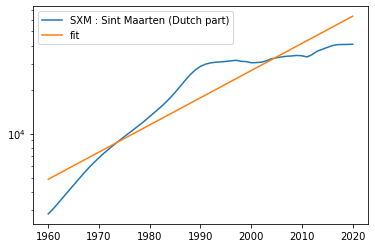

[0.08280754]


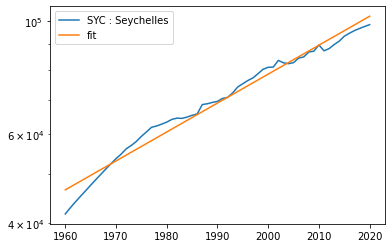

[0.93900412]


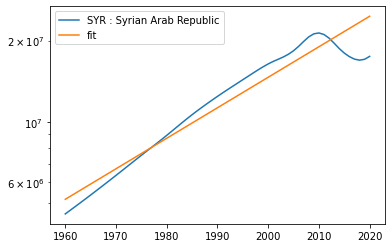

[0.84987796]


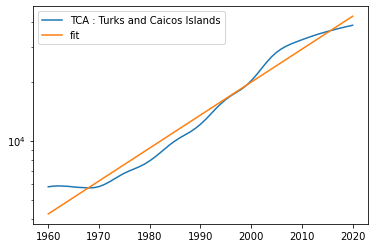

[0.19935753]


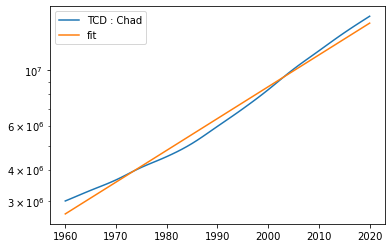

[0.17759555]


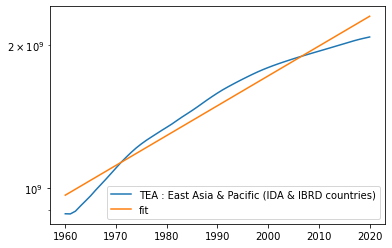

[0.09043762]


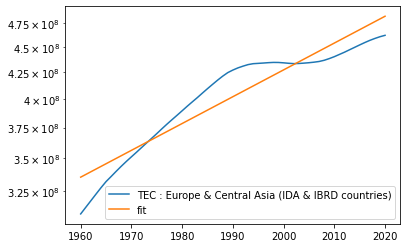

[0.02564621]


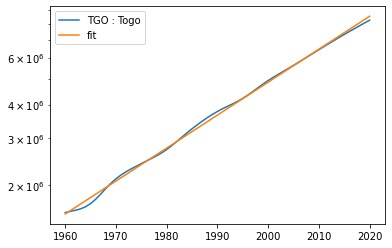

[0.3927471]


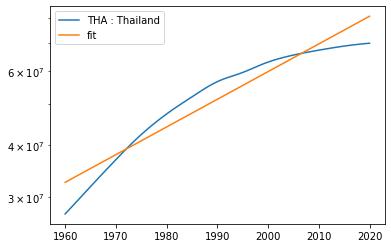

[0.15714497]


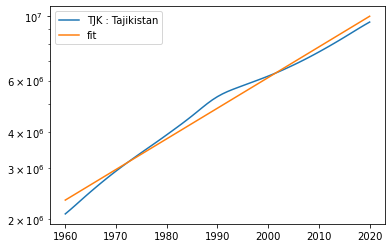

[0.20055447]


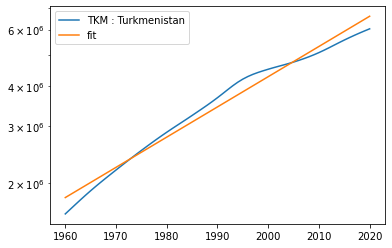

[0.14147163]


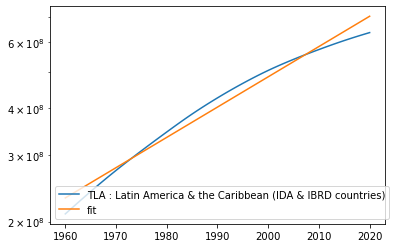

[0.09964143]


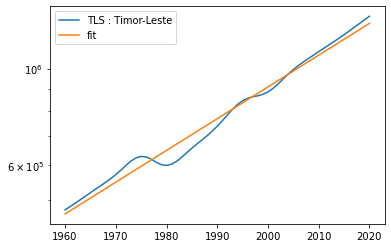

[0.11863359]


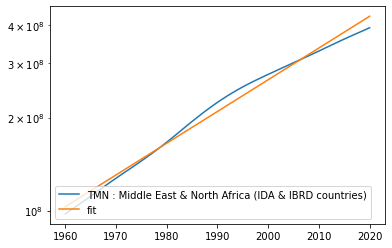

[0.22437727]


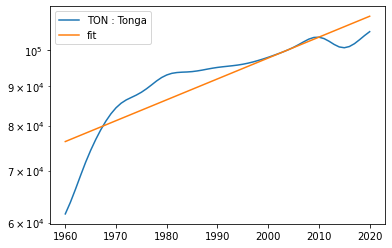

[0.06300497]


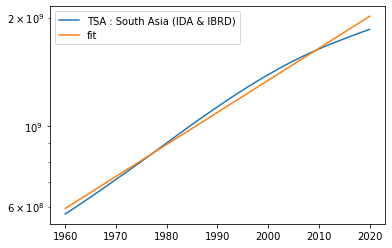

[0.00247299]


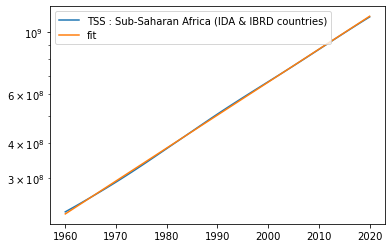

[0.07823379]


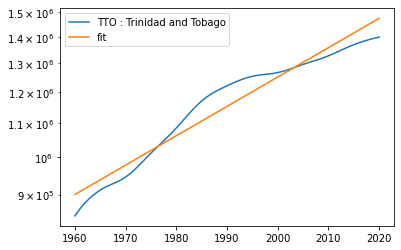

[0.20513775]


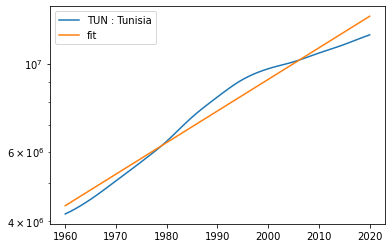

[0.08155961]


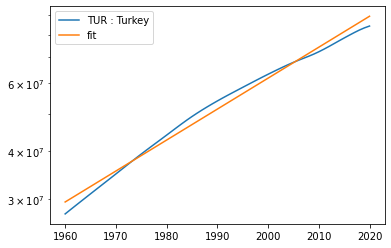

[0.20938054]


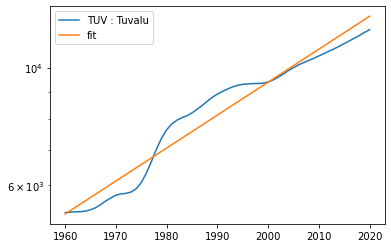

[0.01094691]


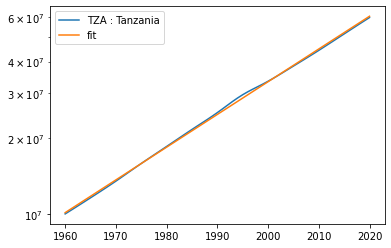

[0.00776437]


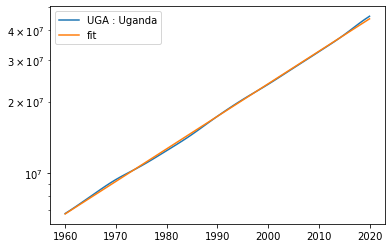

[0.18952542]


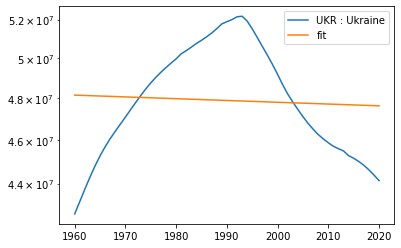

[0.0165193]


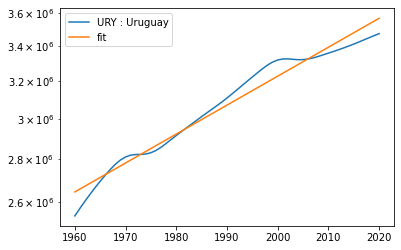

[0.00624405]


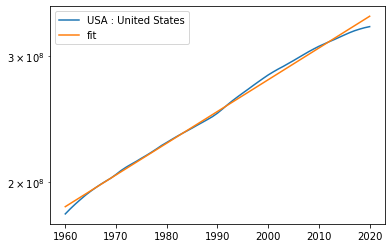

[0.20839124]


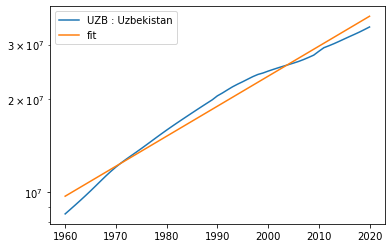

[0.1003529]


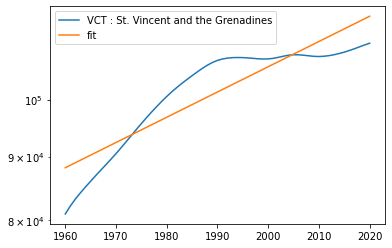

[0.33014441]


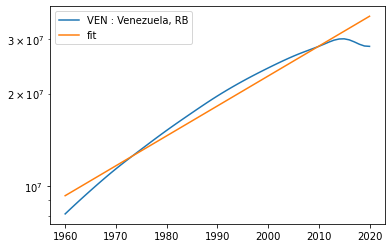

[0.150456]


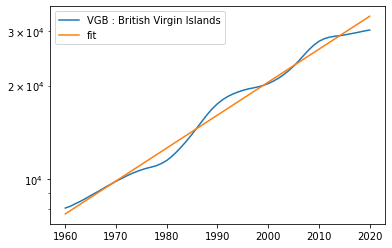

[2.91395136]


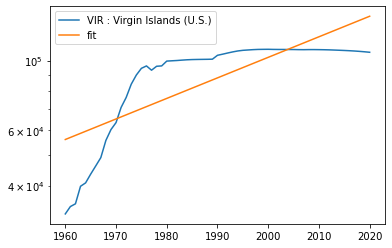

[0.20852809]


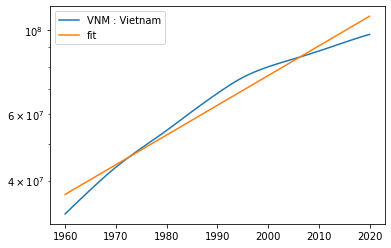

[0.02759129]


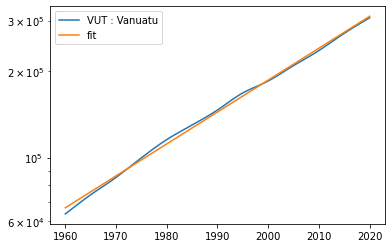

[0.04661726]


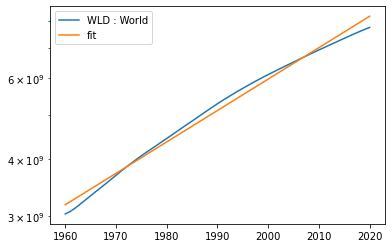

[0.11167779]


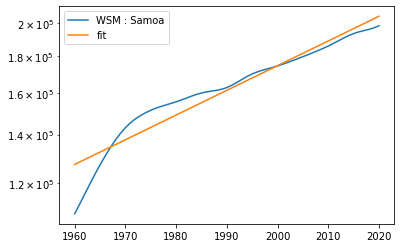

[0.88298507]


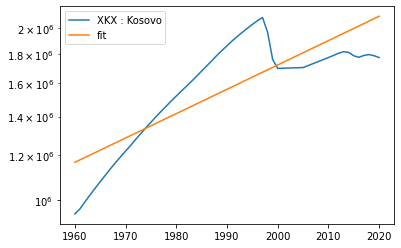

[0.22524918]


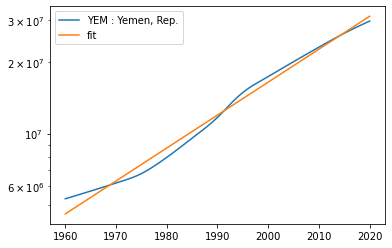

[0.1495937]


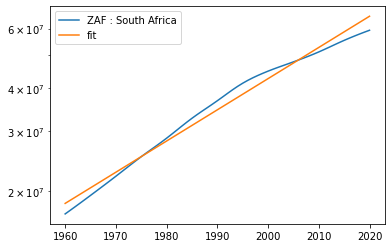

[0.03632367]


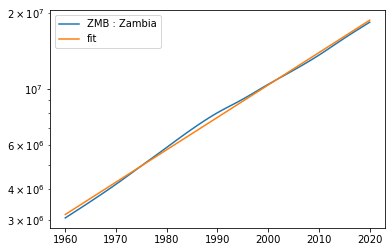

[0.02509985]


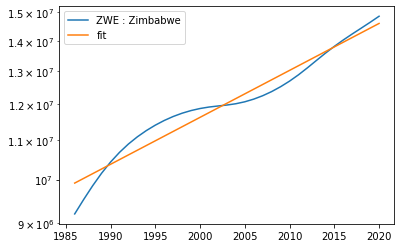

Pass_count total:  258


In [98]:
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

pass_count = 0 
for country in countries[0:261]: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]['value']
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    
    parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)
    if res > 0: # 0.1, < 0 to plot all of them
        y_fit = [fit_funtion(x_i, parameters) for x_i in x] #https://stackoverflow.com/questions/3433486/how-to-do-exponential-and-logarithmic-curve-fitting-in-python-i-found-only-poly
        print(res)
        plt.plot(x,y, label = country + ' : ' + full_name_country)
        plt.plot(x, y_fit, label = 'fit')
        plt.yscale("log")
        plt.legend()
        plt.show()
        pass_count += 1
    
    # https://stackoverflow.com/questions/19189362/getting-the-r-squared-value-using-curve-fit
print('Pass_count total: ', pass_count)
print('Pass_count total (%): ', pass_count*100/len(countries))

## 2. Explore the Exp(t) model last 20 years

In [45]:
# Countries
df_group = df[df['date']>=2000].groupby(['countryiso3code', 'date'])['value'].sum().copy()

countries = df_group.index.get_level_values(0).unique()
print('No. Total countries: ', len(countries))

print('Min. date: ', df['date'].min(), ' year')

No. Total countries:  261
Min. date:  1960.0  year


[5.70039826e-05]


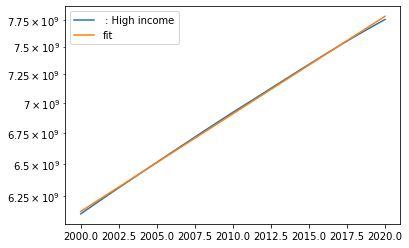

[0.00485602]


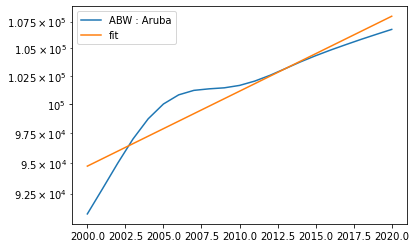

[1.70045617e-05]


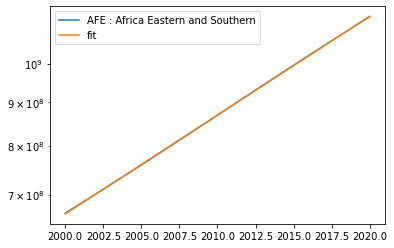

[0.00453174]


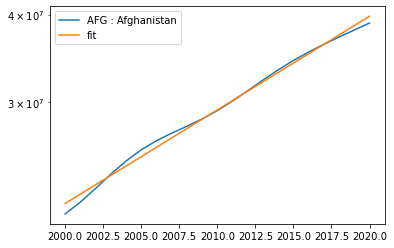

[0.00029462]


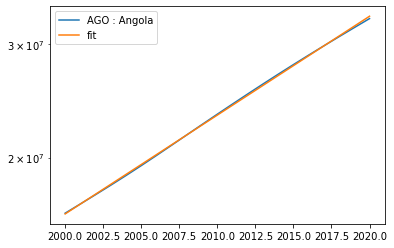

[0.00061621]


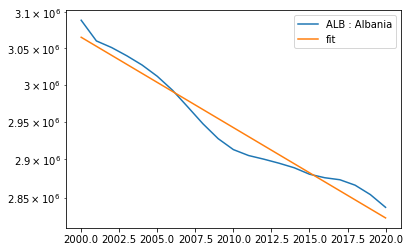

[0.08264769]


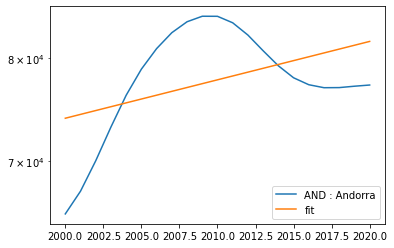

[0.00045948]


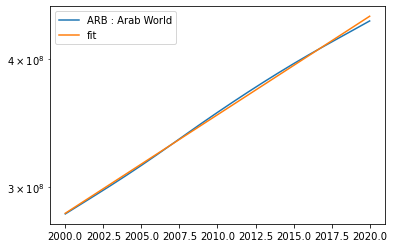

[0.48803304]


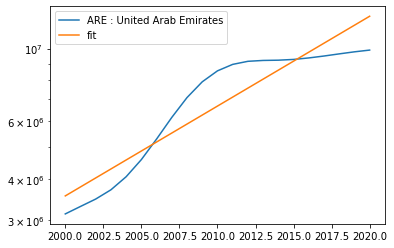

[2.38025447e-05]


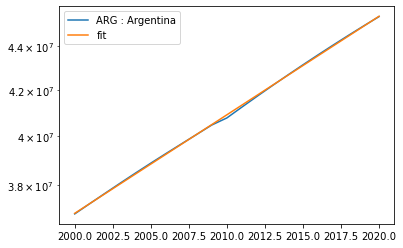

[0.0050652]


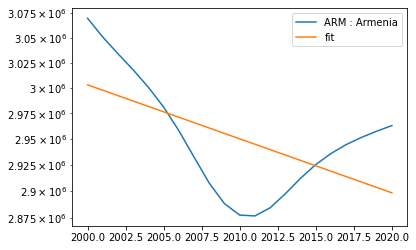

[0.00380859]


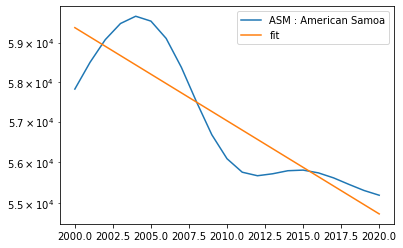

[0.00099192]


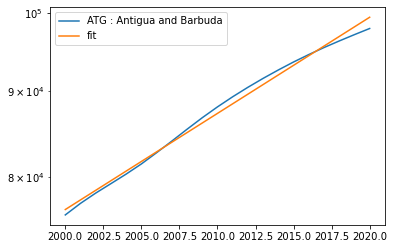

[0.00046929]


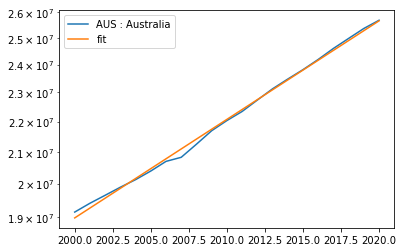

[0.00054548]


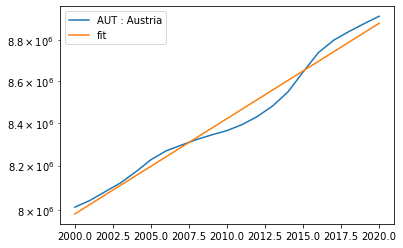

[0.00096071]


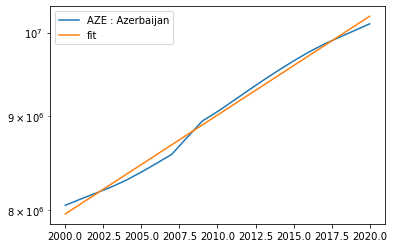

[0.00021021]


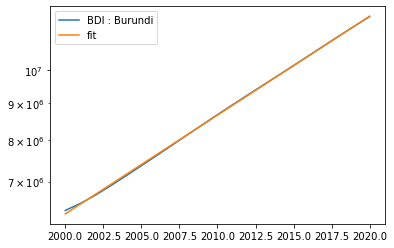

[0.00036571]


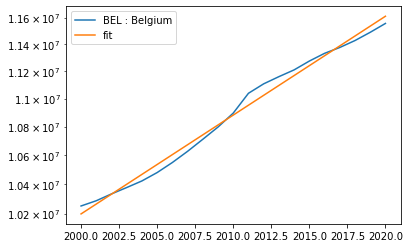

[0.00017613]


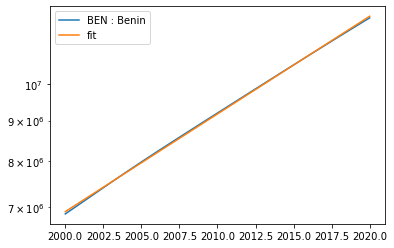

[4.1676247e-05]


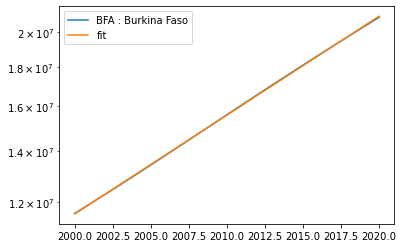

[0.00089049]


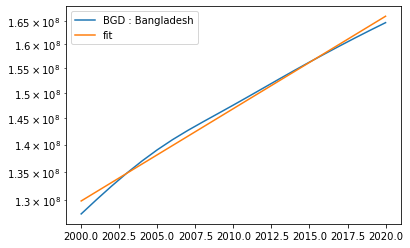

[0.00092242]


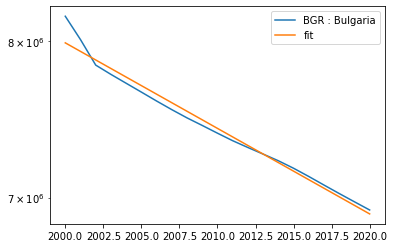

[0.06298625]


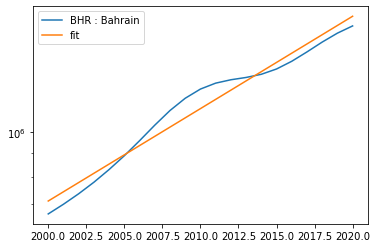

[0.00310311]


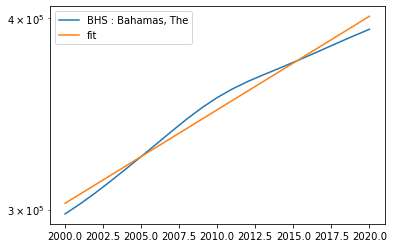

[0.00798402]


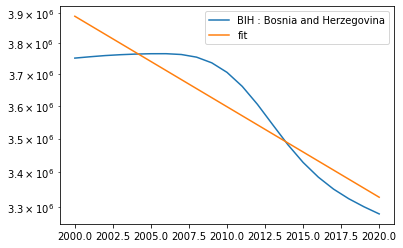

[0.00143613]


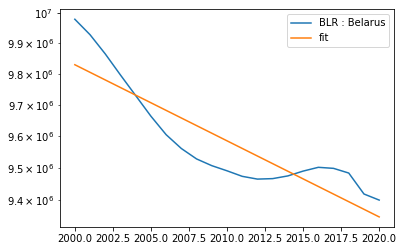

[0.00165254]


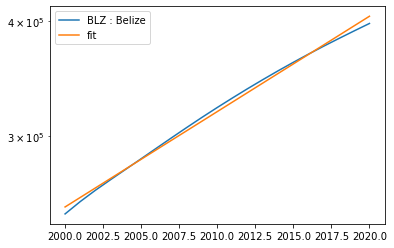

[0.00371298]


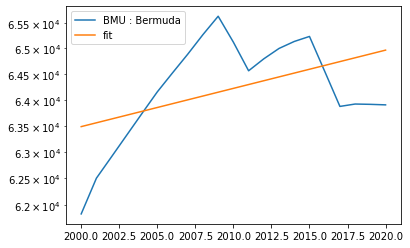

[0.00042083]


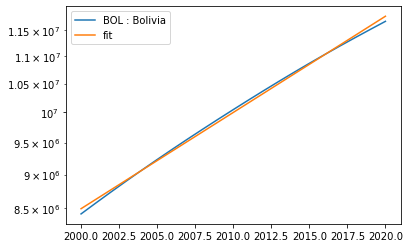

[0.00053443]


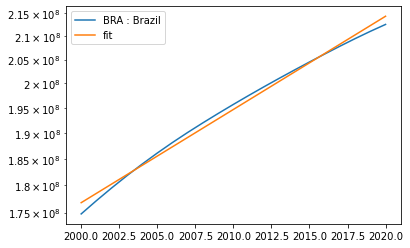

[0.00023485]


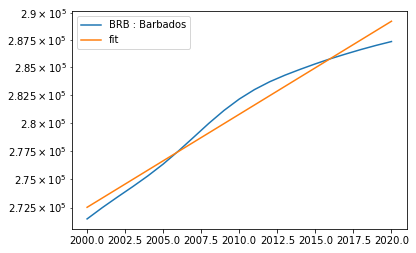

[0.00095766]


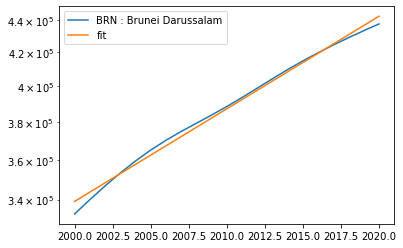

[0.00105099]


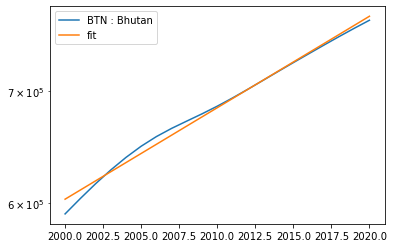

[0.00088918]


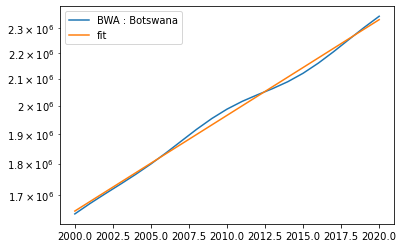

[0.00633423]


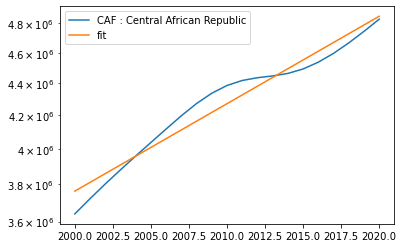

[0.00013217]


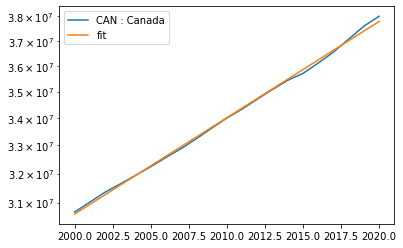

[0.00012569]


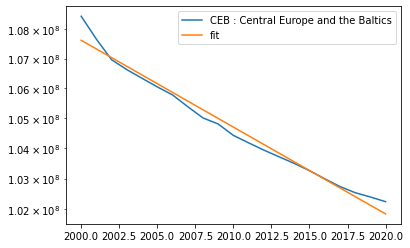

[0.0005041]


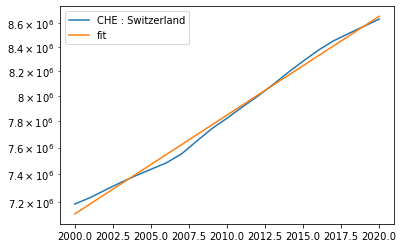

[0.00048747]


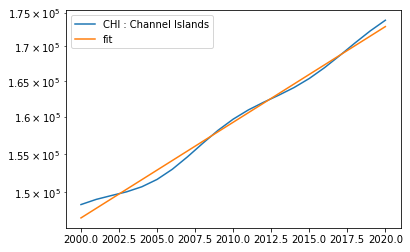

[0.00016186]


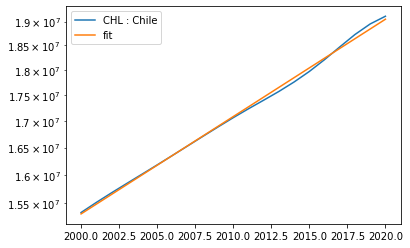

[6.30294934e-05]


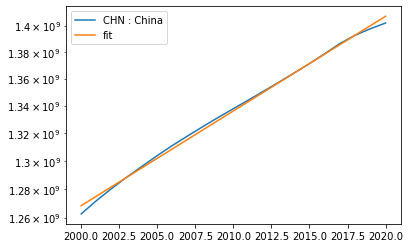

[0.00056416]


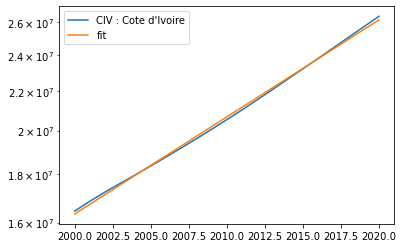

[3.32565751e-05]


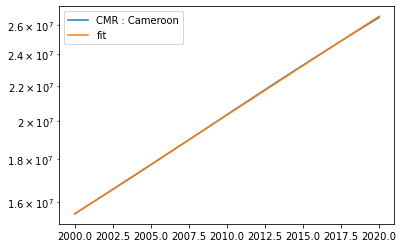

[0.00016763]


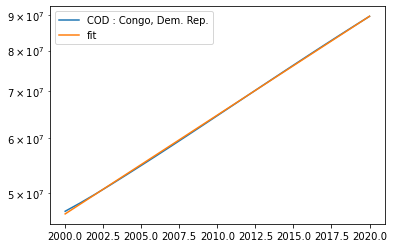

[0.0020253]


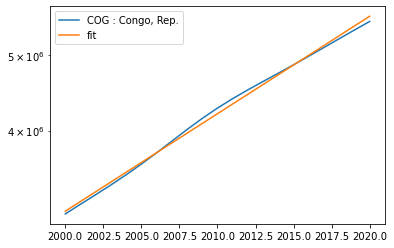

[0.00043632]


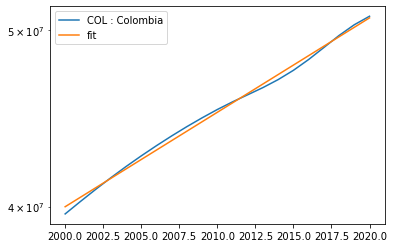

[5.85778436e-05]


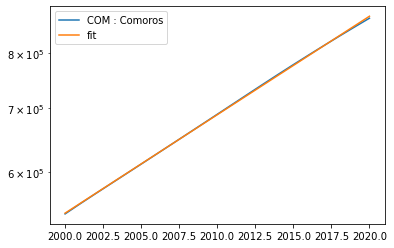

[0.00027288]


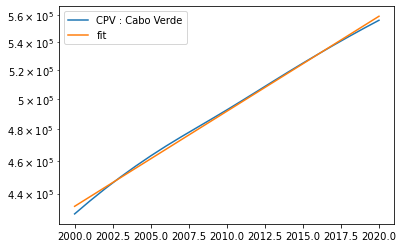

[0.00074444]


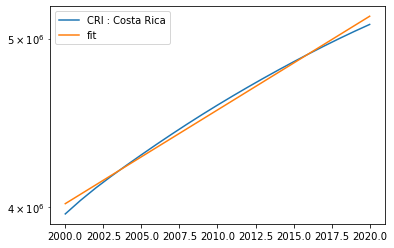

[1.45207004e-05]


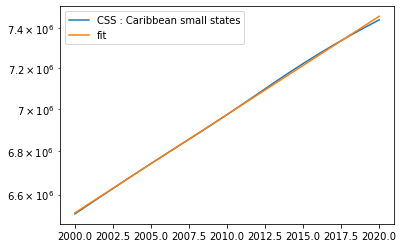

[0.00011064]


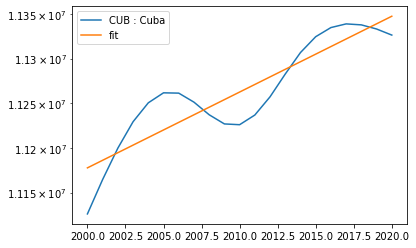

[0.0105623]


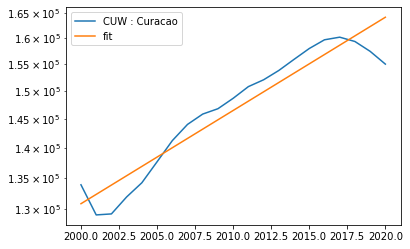

[0.01089811]


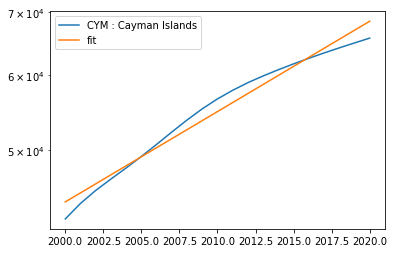

[0.00383863]


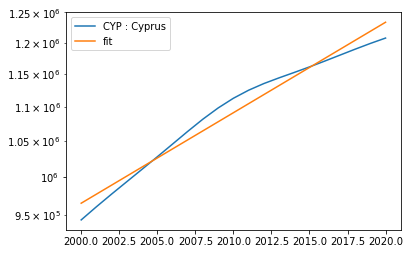

[0.00038086]


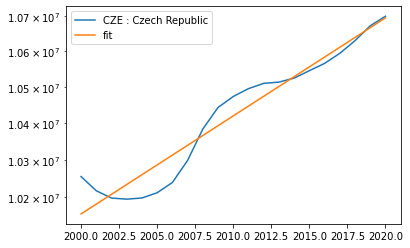

[0.00208533]


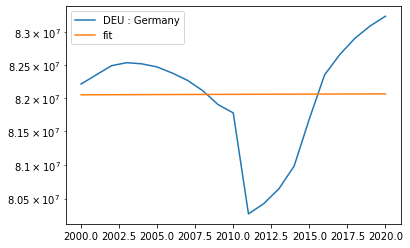

[0.00018586]


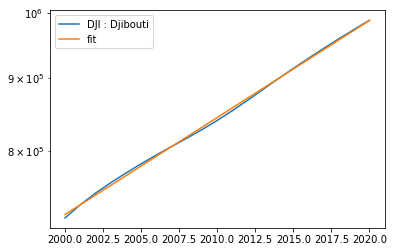

[0.00011047]


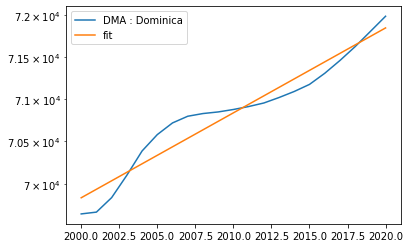

[0.00022141]


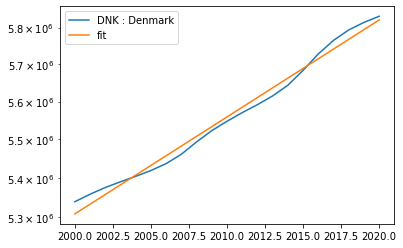

[0.00028447]


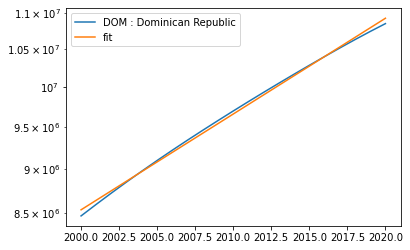

[0.00163499]


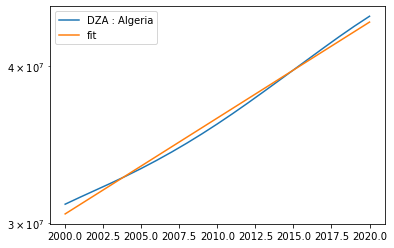

[6.36599545e-05]


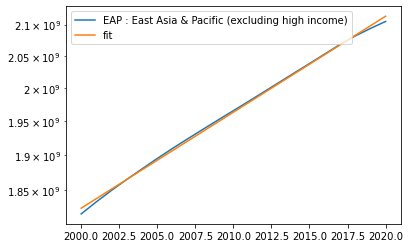

[0.00037069]


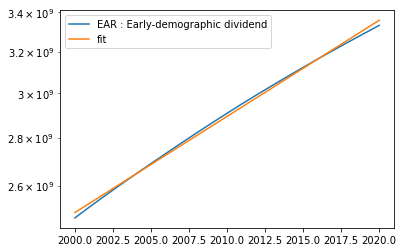

[6.36905214e-05]


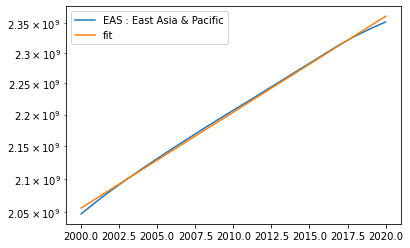

[0.00099283]


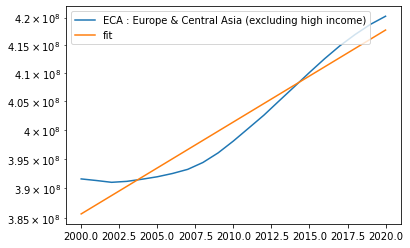

[8.84300802e-05]


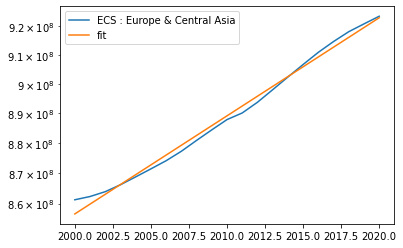

[6.43167926e-05]


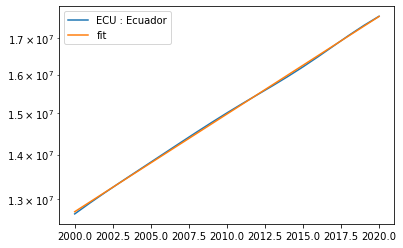

[0.0005353]


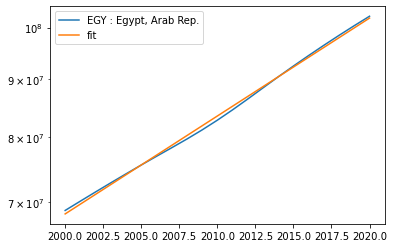

[0.00035605]


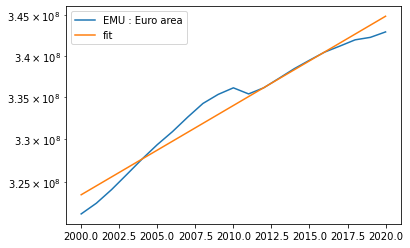

[0.01084169]


<ipython-input-105-a558e993c719>:10: RuntimeWarning: divide by zero encountered in log
  parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)


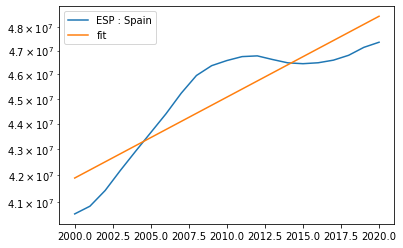

[0.00160433]


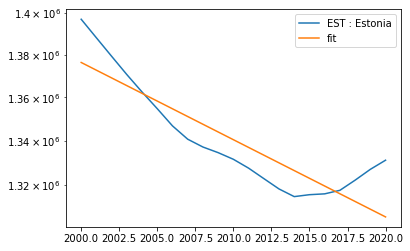

[7.00017939e-05]


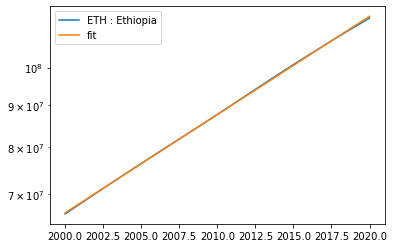

[0.00012944]


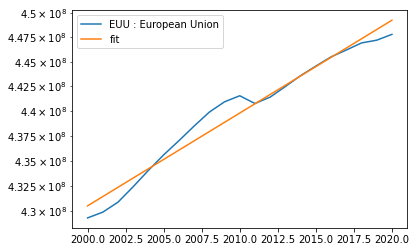

[0.00024785]


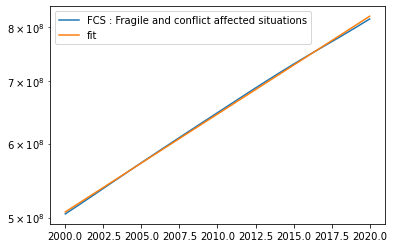

[0.00014486]


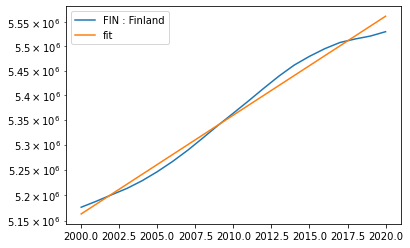

[0.00069273]


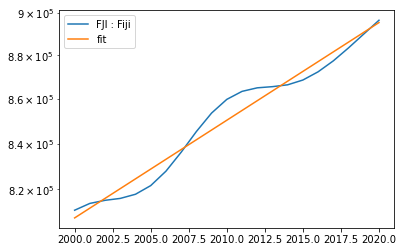

[0.00055822]


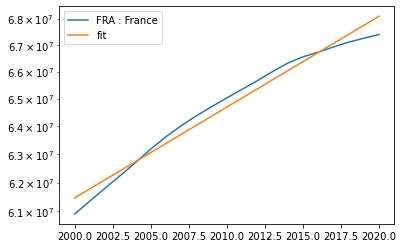

[0.00028213]


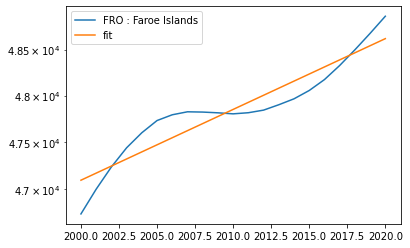

[0.01371714]


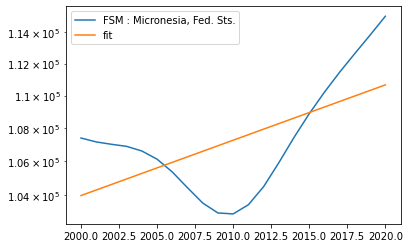

[0.00270944]


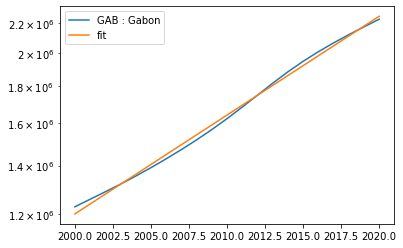

[0.00011146]


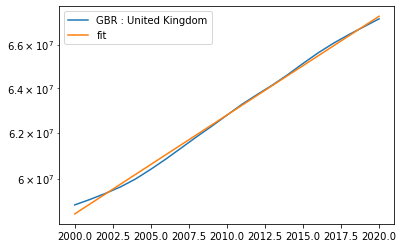

[0.00195142]


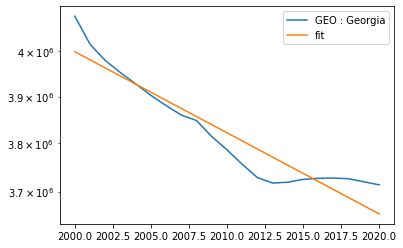

[0.00037161]


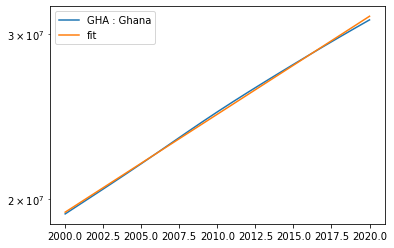

[0.00418843]


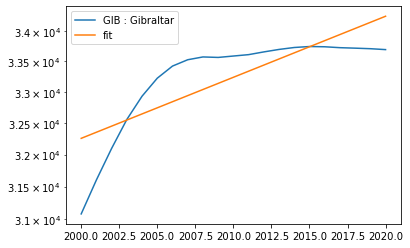

[0.00124761]


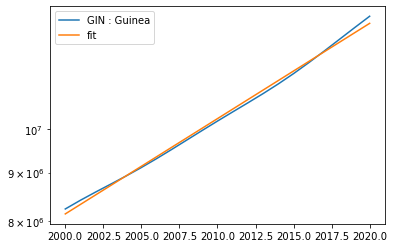

[7.92358789e-05]


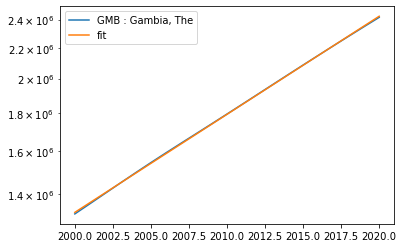

[0.00030115]


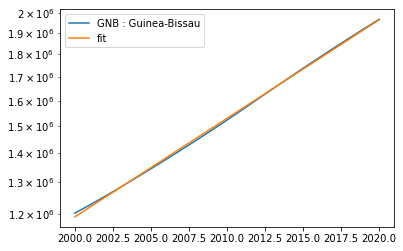

[0.00185419]


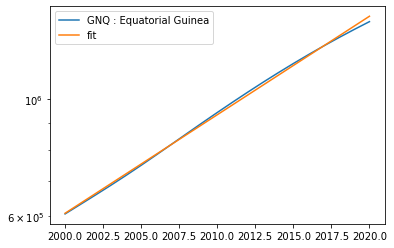

[0.00254156]


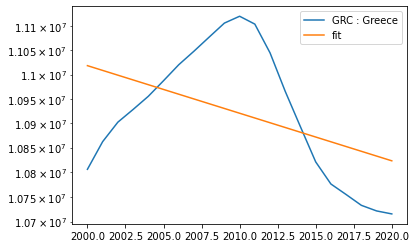

[0.00040139]


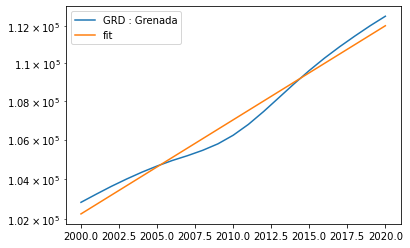

[0.00044671]


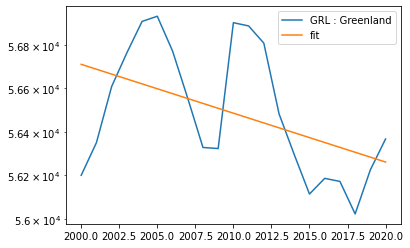

[0.0008868]


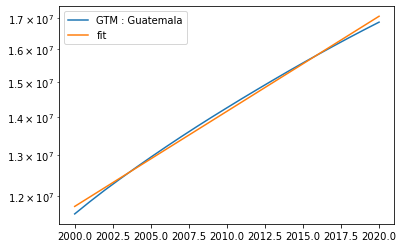

[0.00111885]


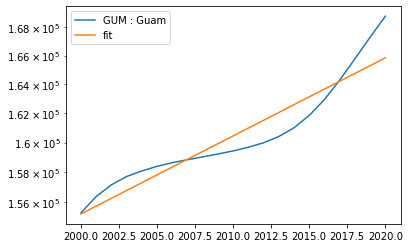

[0.0010634]


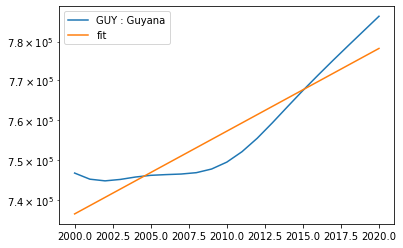

[0.0002949]


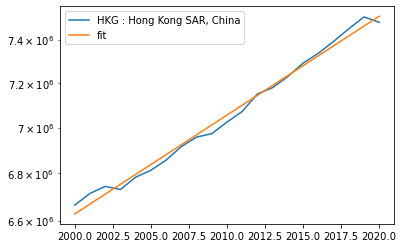

[0.00206715]


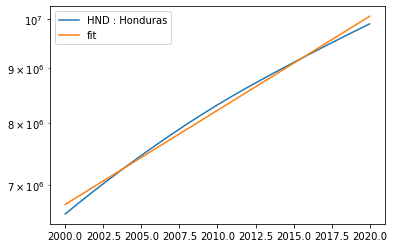

[1.25040063e-05]


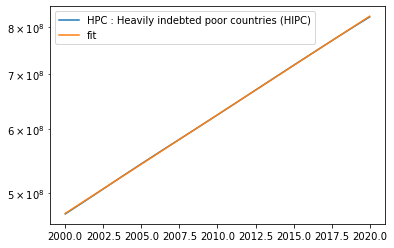

[0.00242126]


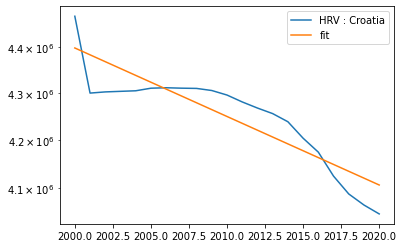

[0.00036852]


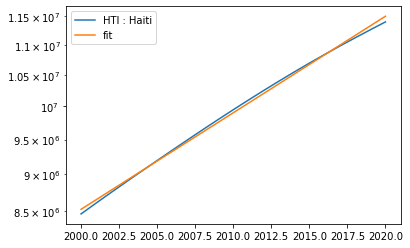

[4.07996987e-05]


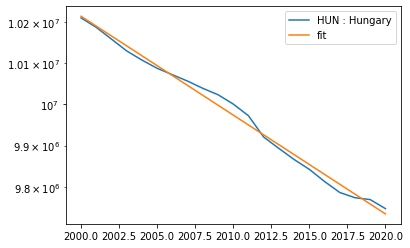

[8.94722074e-05]


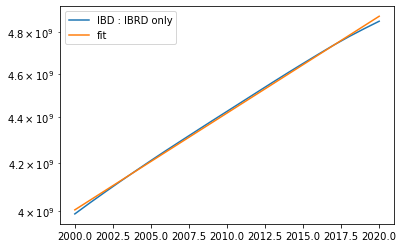

[4.67590927e-05]


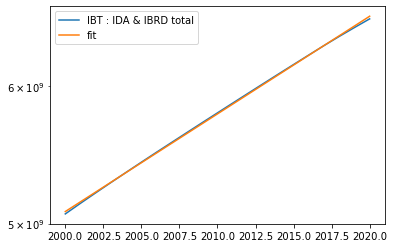

[7.76985706e-05]


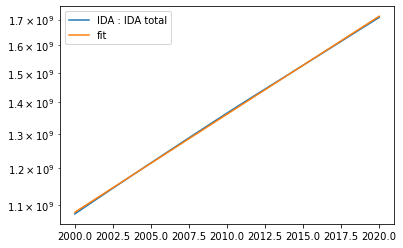

[3.63745971e-05]


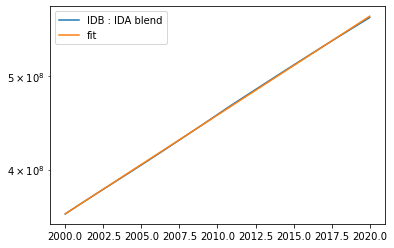

[9.24435548e-05]


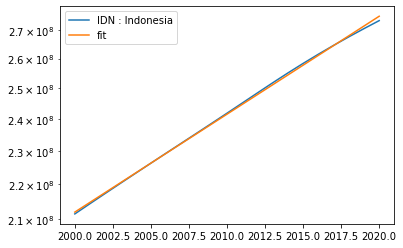

[0.00014757]


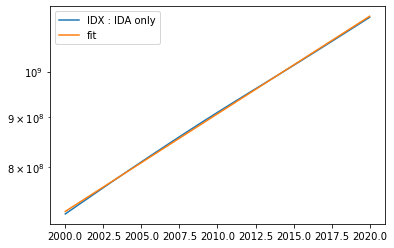

[0.00596587]


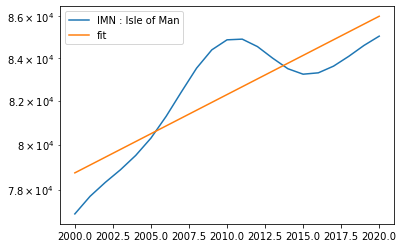

[0.00107626]


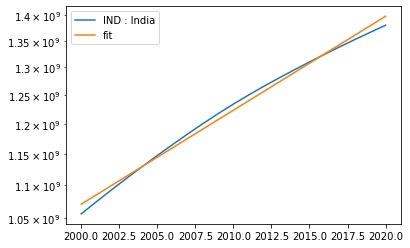

[0.00710014]


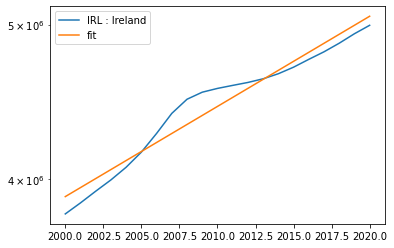

[0.00014843]


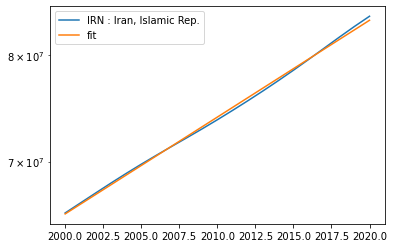

[0.00443024]


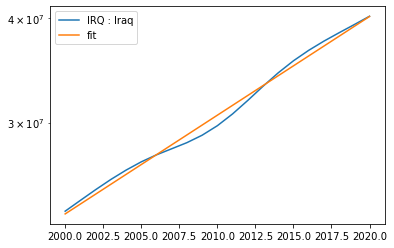

[0.0038206]


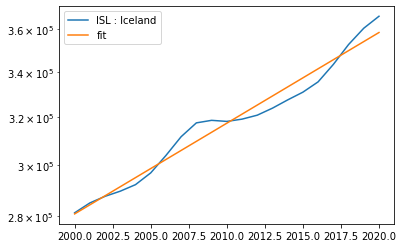

[6.30630681e-05]


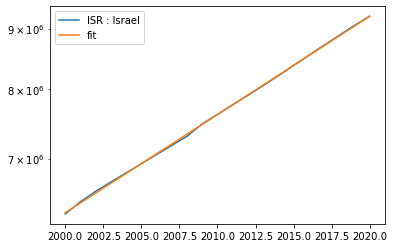

[0.00168465]


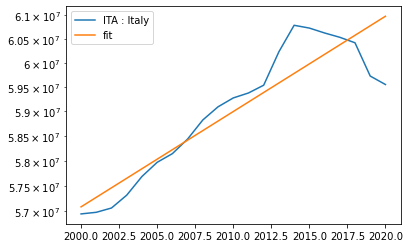

[2.67307877e-05]


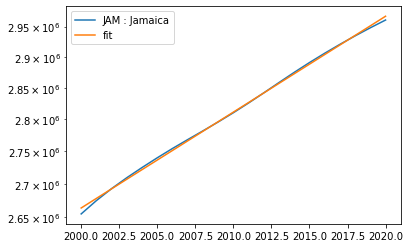

[0.02000305]


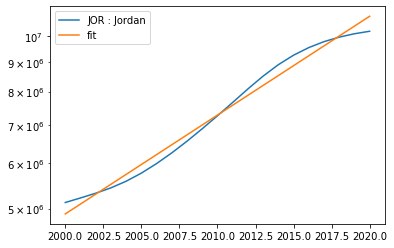

[0.00033037]


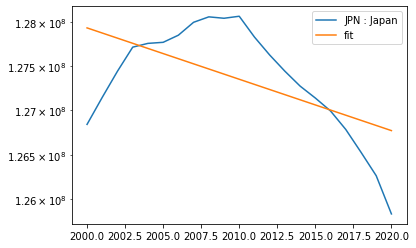

[0.00272777]


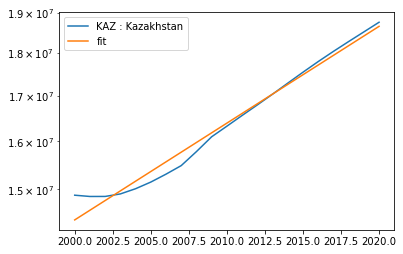

[0.00050215]


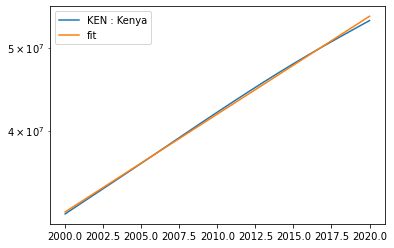

[0.00411583]


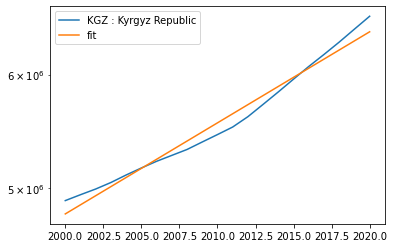

[9.117473e-05]


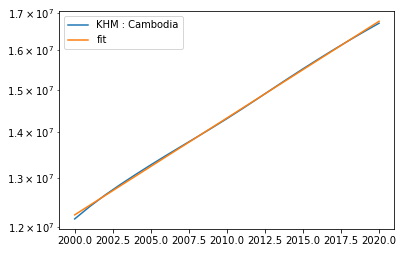

[0.00167908]


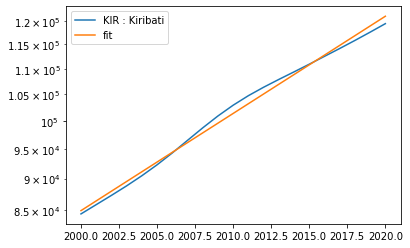

[0.0004276]


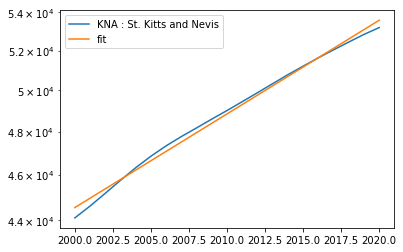

[0.00013536]


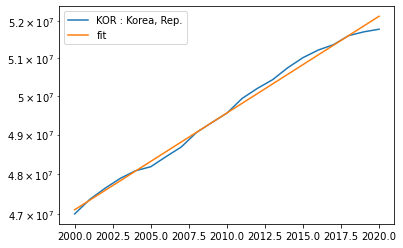

[0.02948392]


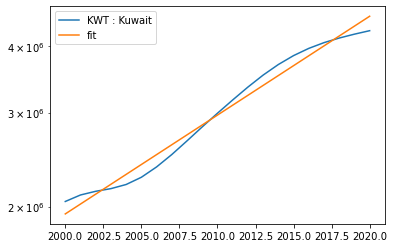

[0.00035634]


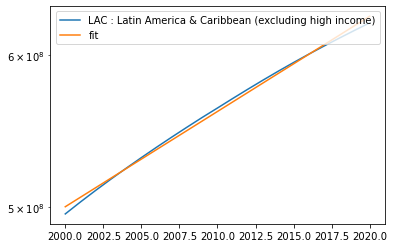

[4.35181202e-05]


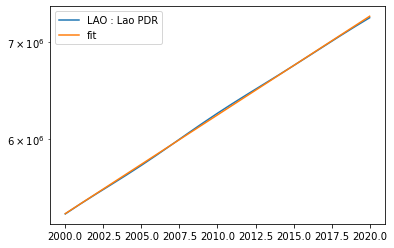

[0.03034484]


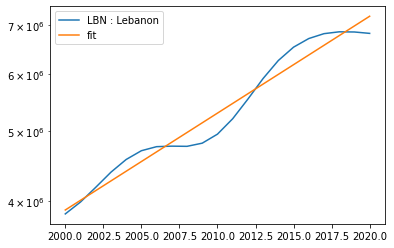

[0.0037931]


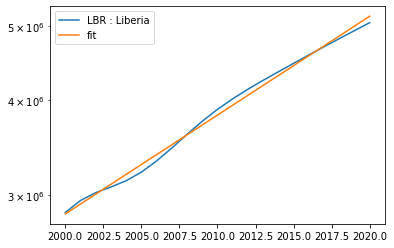

[0.00172926]


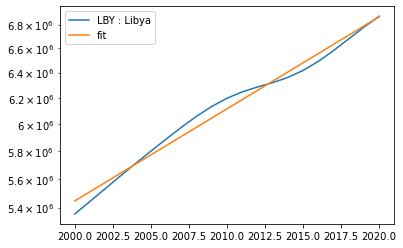

[0.00170038]


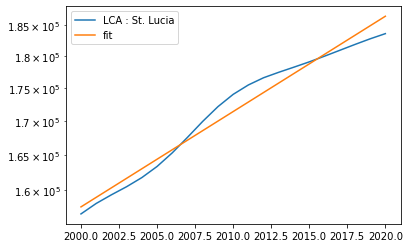

[0.00032939]


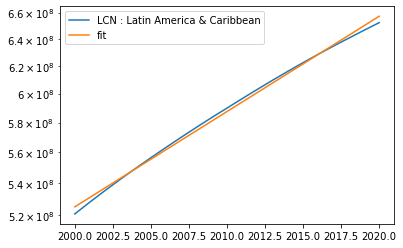

[4.64113835e-05]


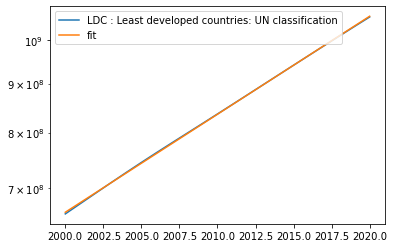

[0.00047995]


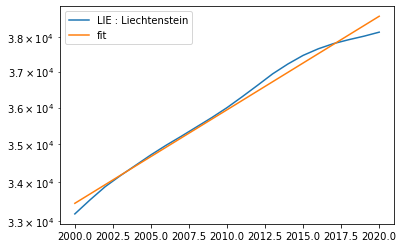

[0.00024095]


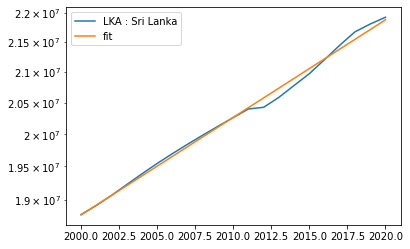

[4.95494708e-05]


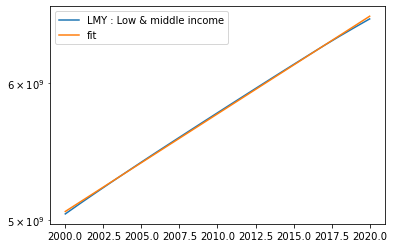

[0.00524764]


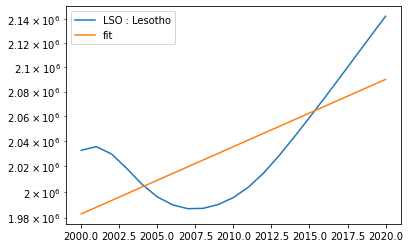

[2.80411061e-05]


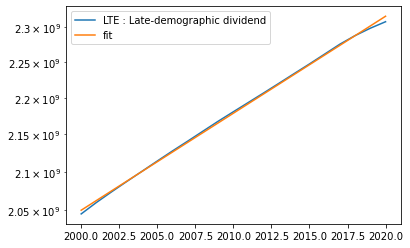

[0.00130255]


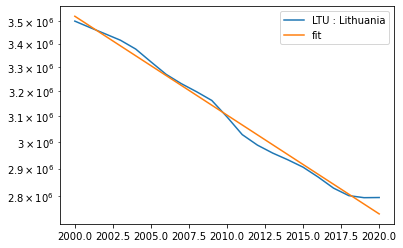

[0.00302138]


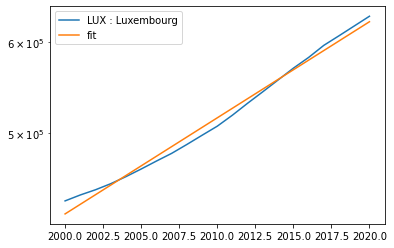

[0.00101014]


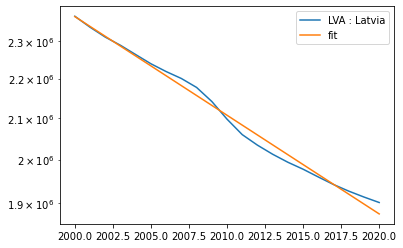

[0.00153243]


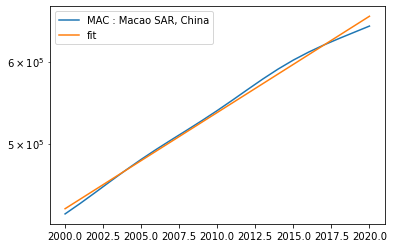

[0.04431701]


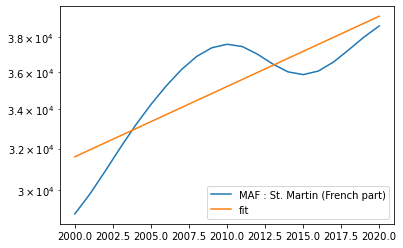

[0.00019308]


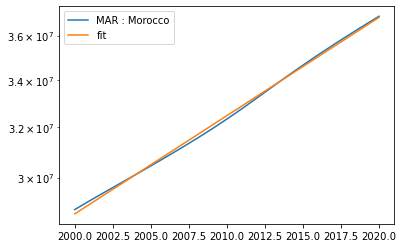

[0.00015499]


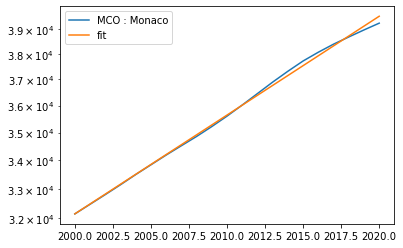

[0.00473822]


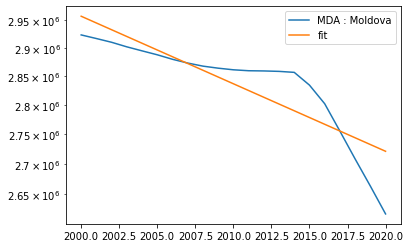

[0.00033936]


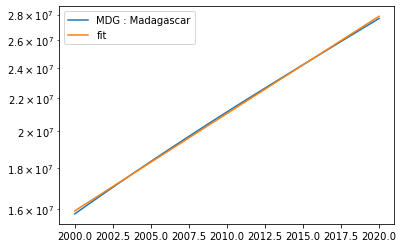

[0.01177558]


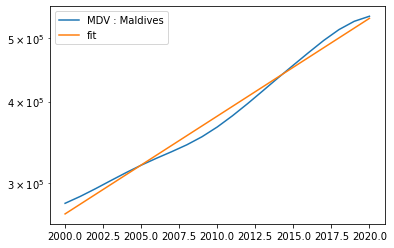

[0.00029321]


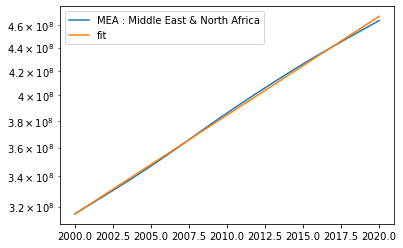

[0.00027922]


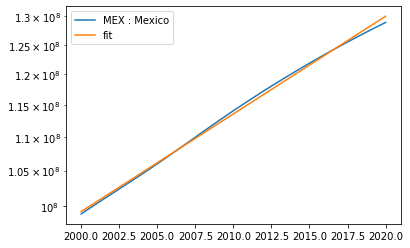

[0.00435931]


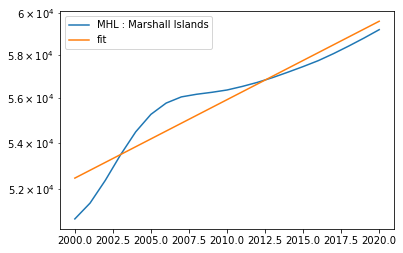

[5.77076547e-05]


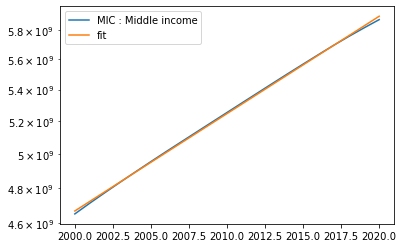

[7.65131205e-05]


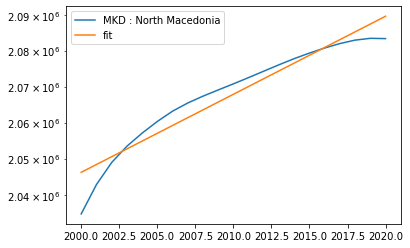

[0.0003359]


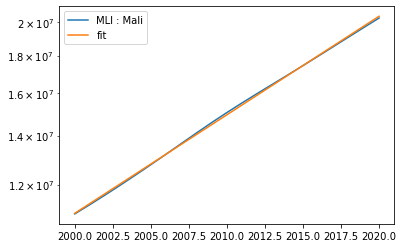

[0.02167978]


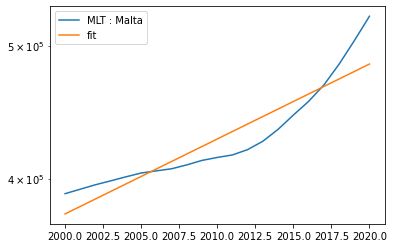

[0.00010579]


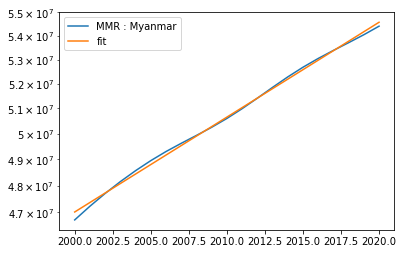

[1.35205482e-05]


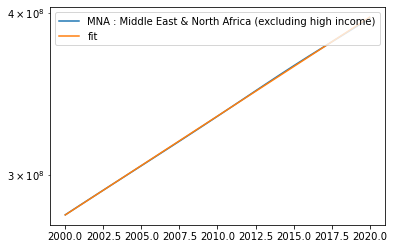

[0.0001973]


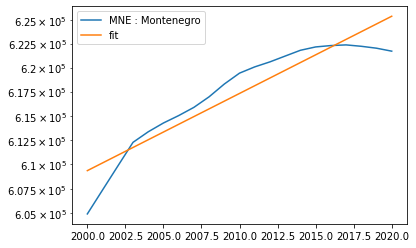

[0.00236571]


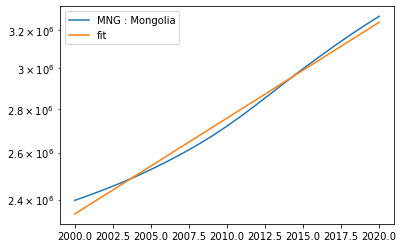

[0.01267577]


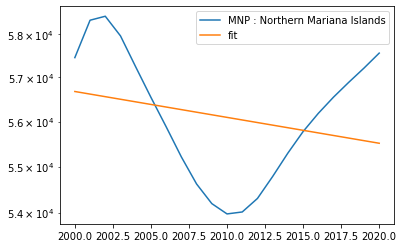

[5.88750055e-05]


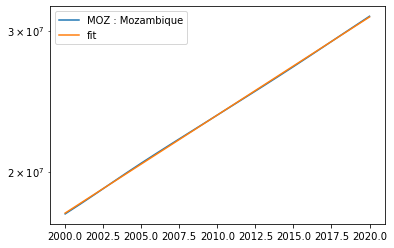

[4.75526597e-05]


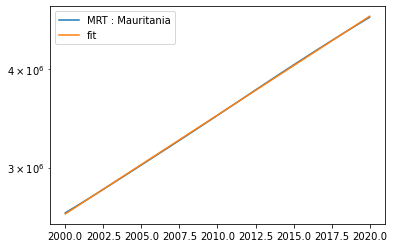

[0.00096196]


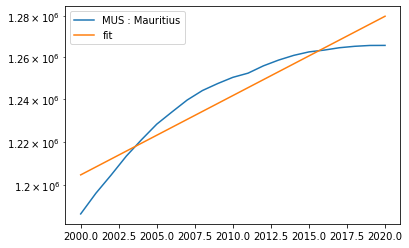

[0.00023898]


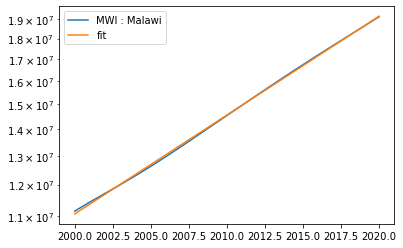

[0.00182526]


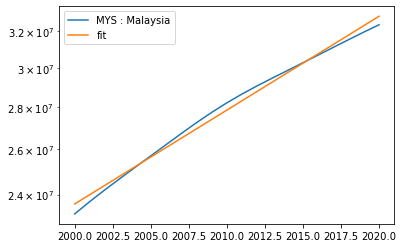

[0.00030086]


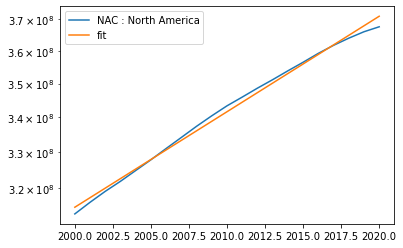

[0.00021445]


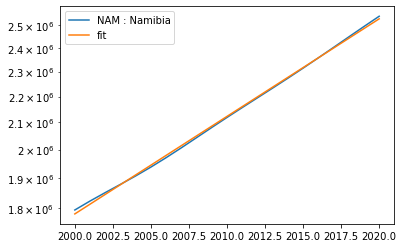

[0.00520082]


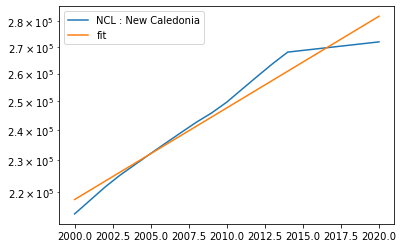

[0.00010193]


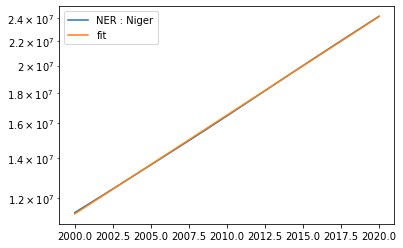

[3.14115792e-05]


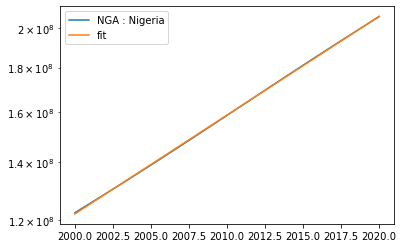

[5.032183e-05]


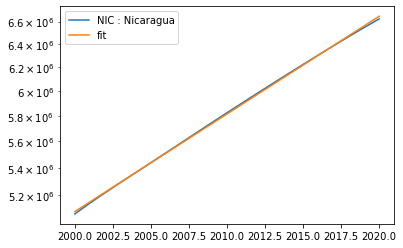

[0.0001561]


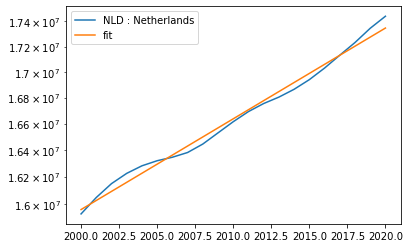

[0.00086533]


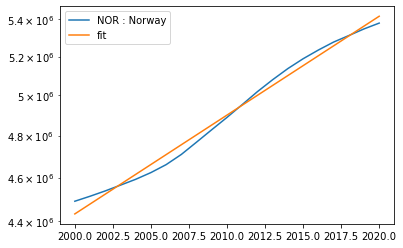

[0.00453105]


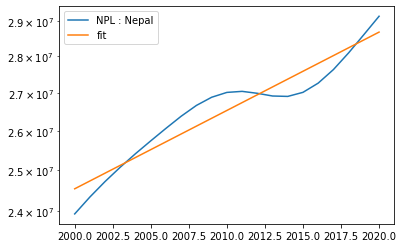

[0.00896105]


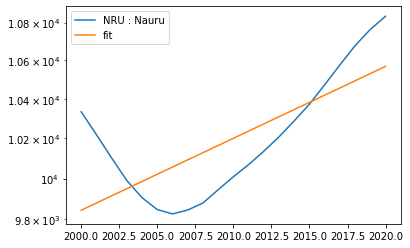

[0.00264545]


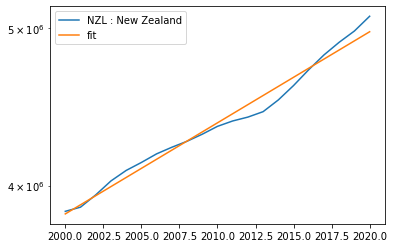

[8.51884826e-05]


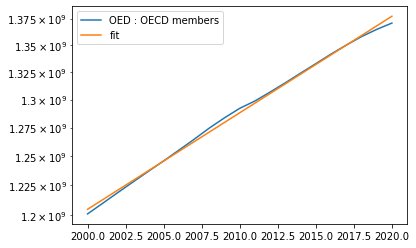

[0.0485604]


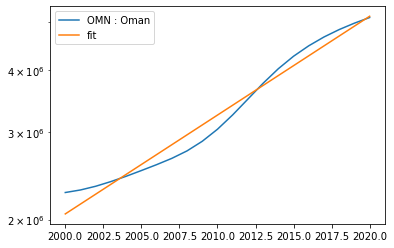

[0.00078184]


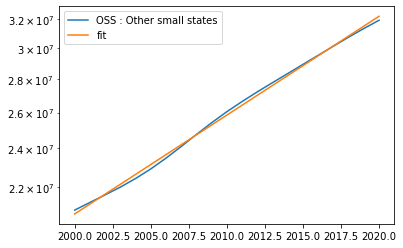

[0.00028072]


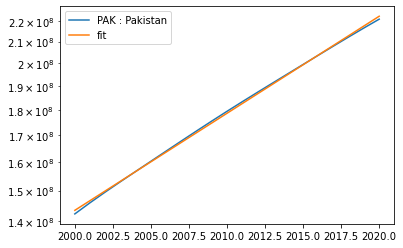

[0.00011235]


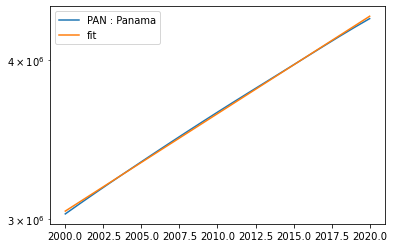

[0.00144352]


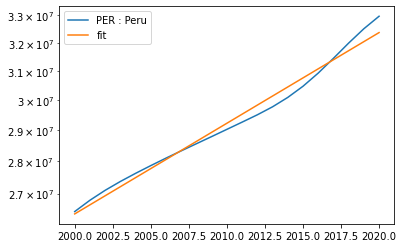

[0.00068329]


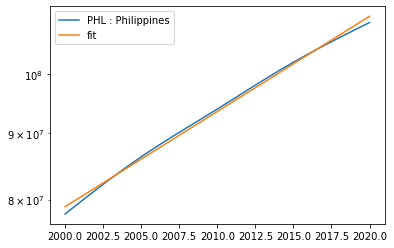

[0.01354575]


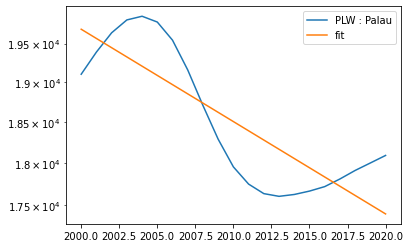

[0.00034941]


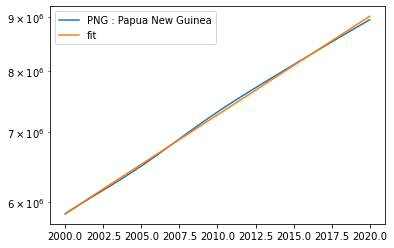

[5.27992101e-06]


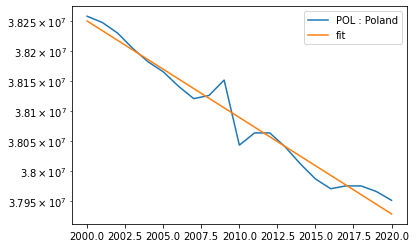

[2.1504354e-05]


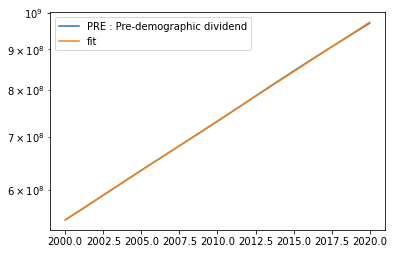

[0.01256376]


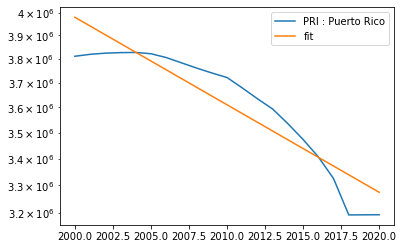

[0.00028947]


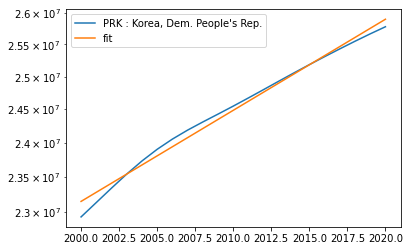

[0.00174985]


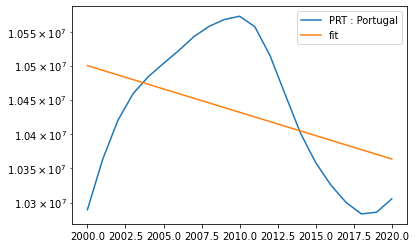

[0.00053422]


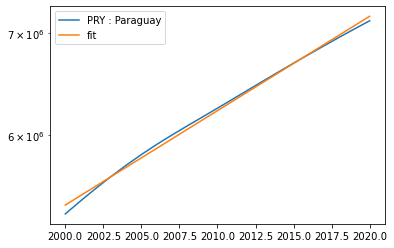

[0.00034566]


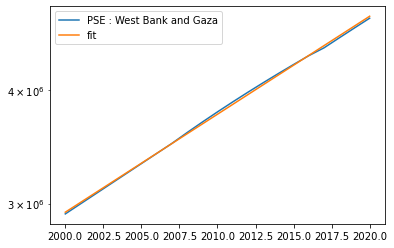

[0.00014505]


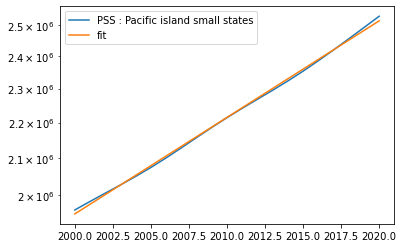

[0.00010439]


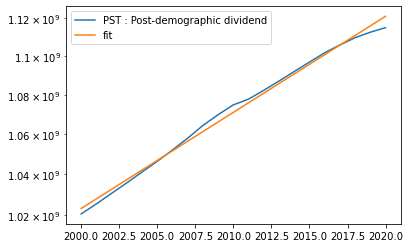

[0.0020766]


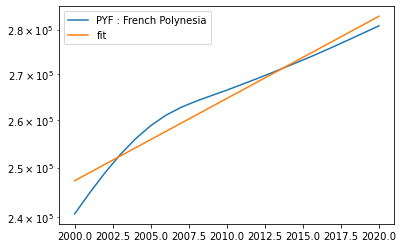

[0.42827527]


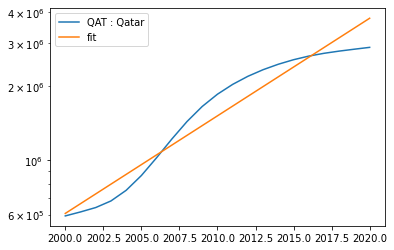

[0.00145716]


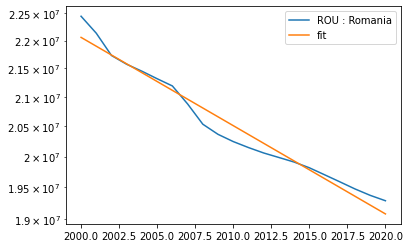

[0.00099969]


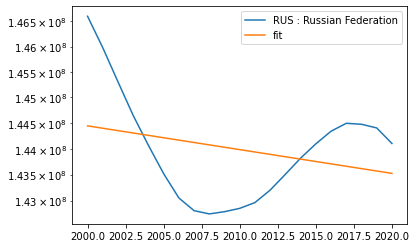

[0.00117244]


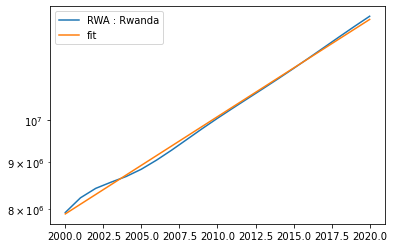

[0.00086245]


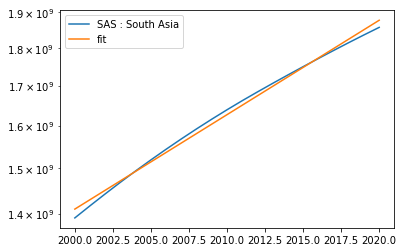

[0.00232904]


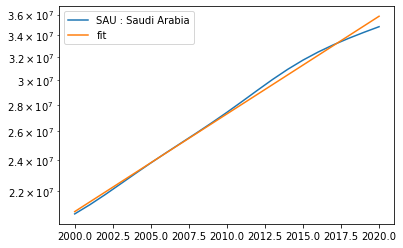

[0.00013192]


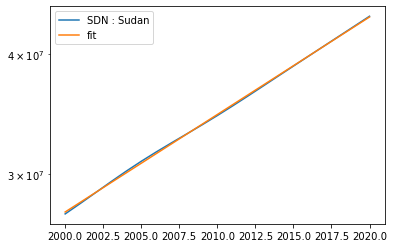

[0.00027997]


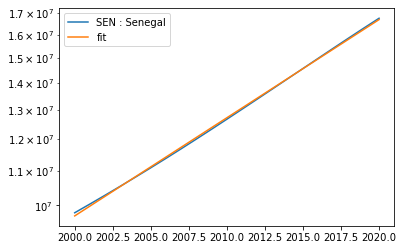

[0.01845135]


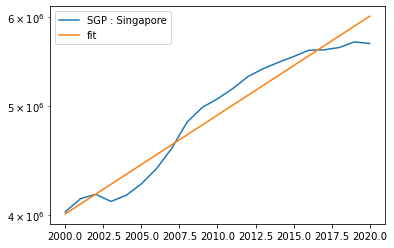

[0.00028779]


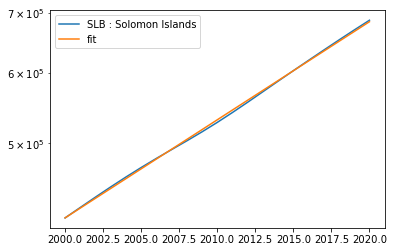

[0.01139933]


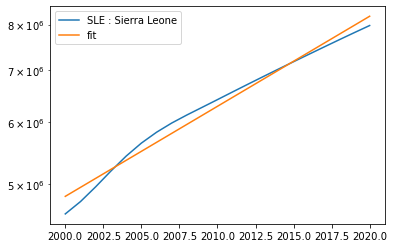

[2.30125985e-05]


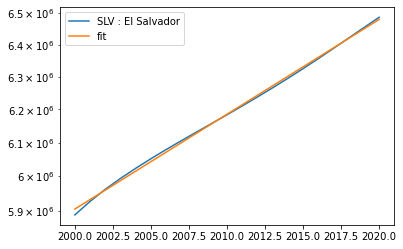

[0.00190281]


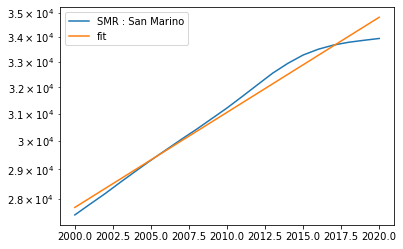

[0.00064254]


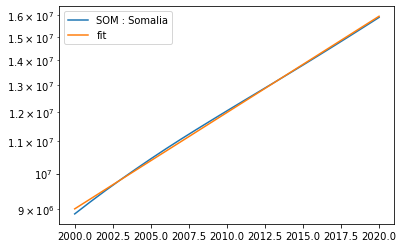

[0.00028297]


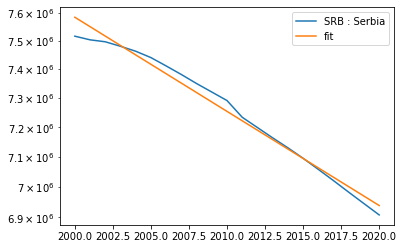

[1.69914241e-05]


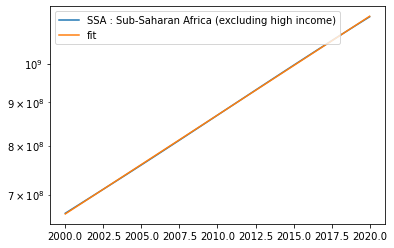

[0.0450283]


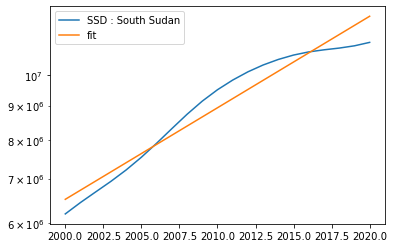

[1.70045617e-05]


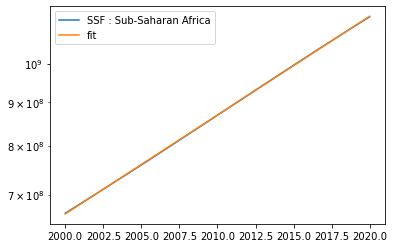

[0.00040472]


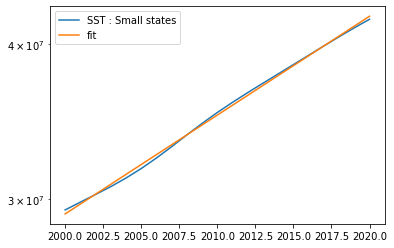

[0.0017783]


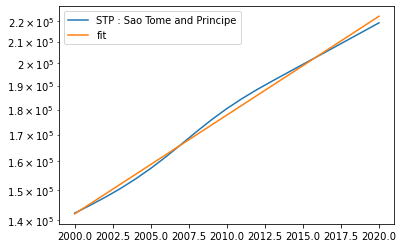

[0.00011148]


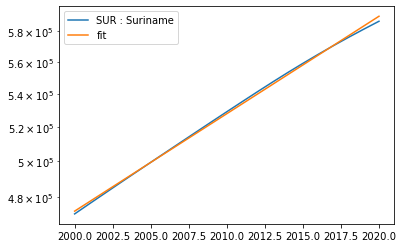

[9.10866849e-05]


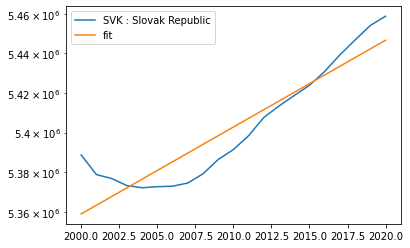

[0.00023189]


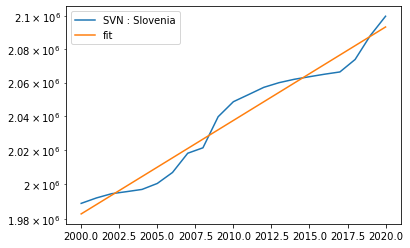

[0.00151234]


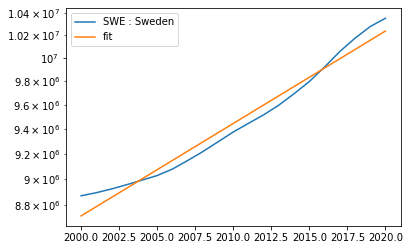

[0.00063773]


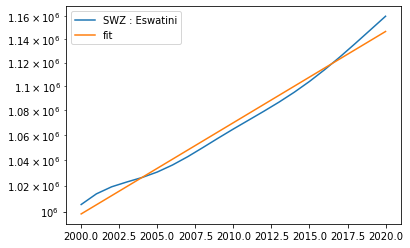

[0.01185647]


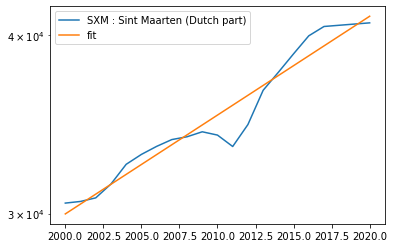

[0.00310493]


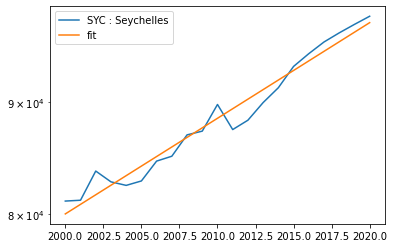

[0.15090033]


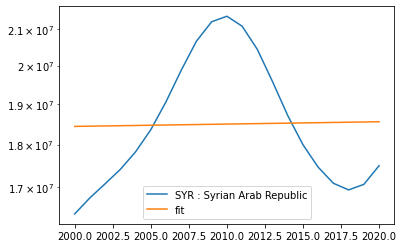

[0.06831574]


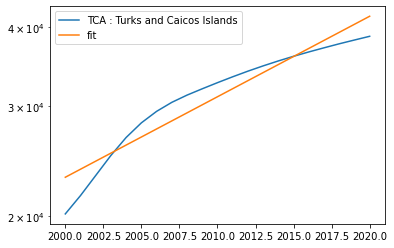

[0.00106972]


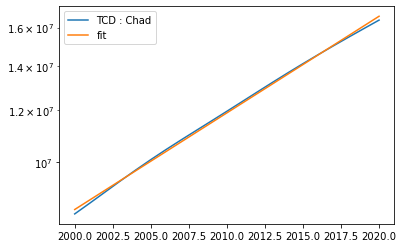

[6.20770465e-05]


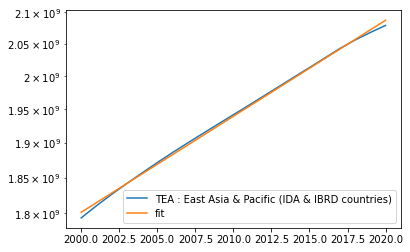

[0.00080861]


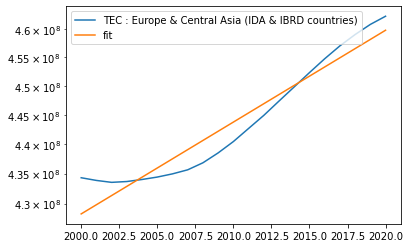

[0.00011171]


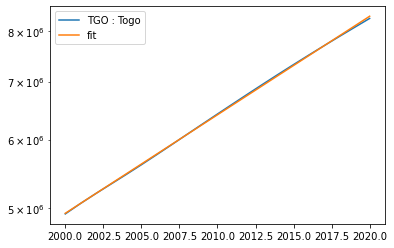

[0.00041513]


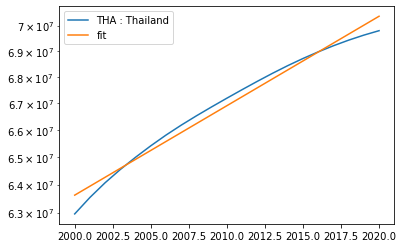

[0.00124848]


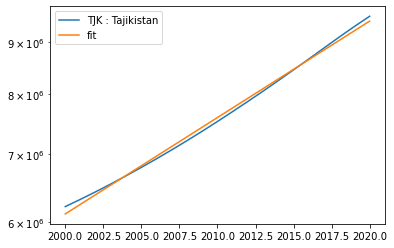

[0.00177214]


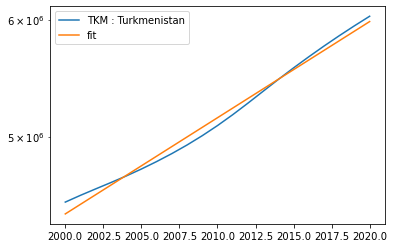

[0.00033194]


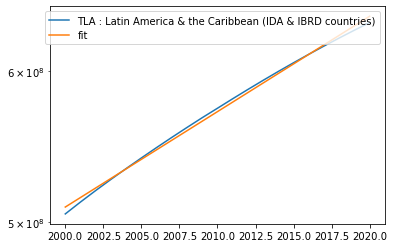

[0.00089105]


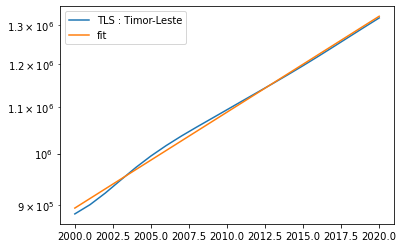

[1.33775468e-05]


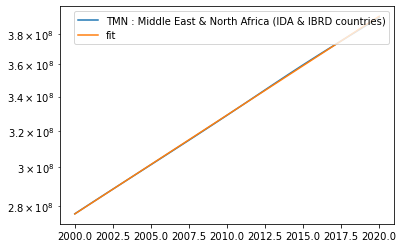

[0.00408624]


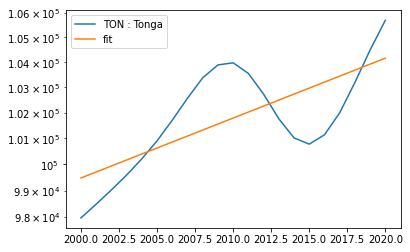

[0.00086245]


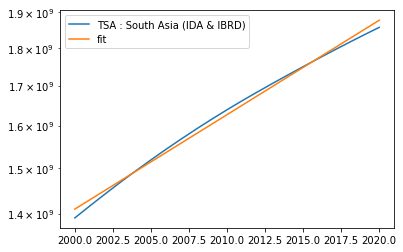

[1.70045617e-05]


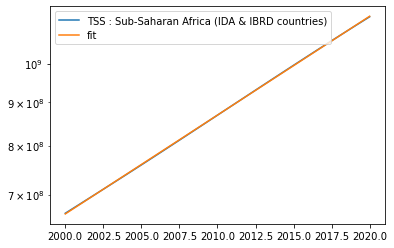

[6.64636682e-05]


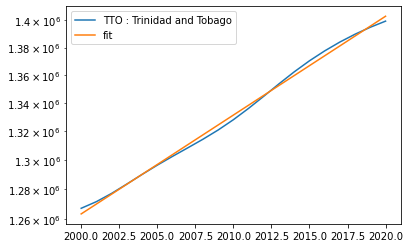

[0.00019187]


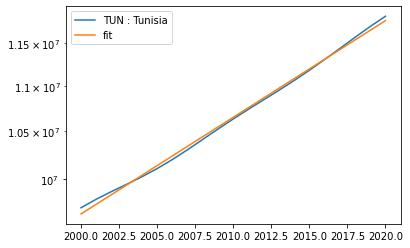

[0.00039539]


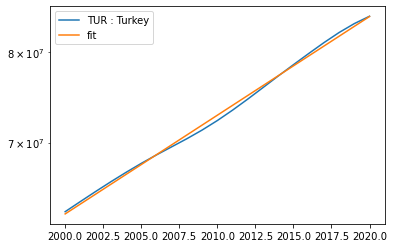

[0.00015435]


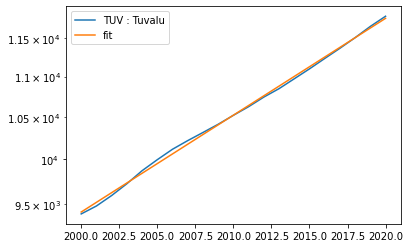

[0.00016455]


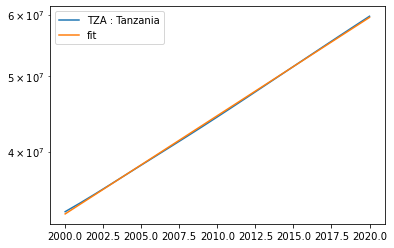

[0.00069271]


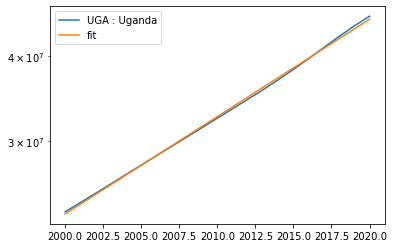

[0.00070391]


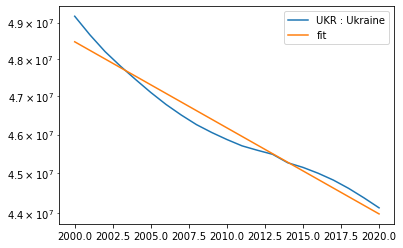

[0.00036444]


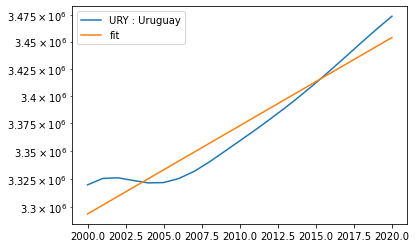

[0.00041415]


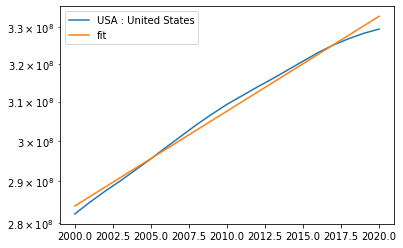

[0.00166428]


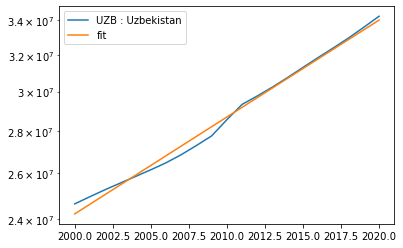

[0.00033621]


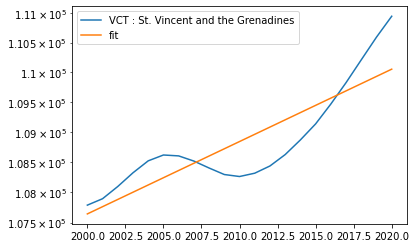

[0.02202797]


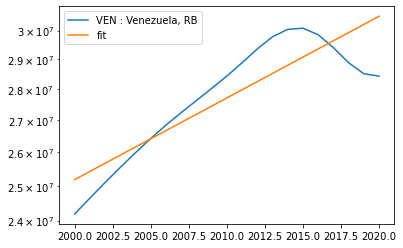

[0.03368894]


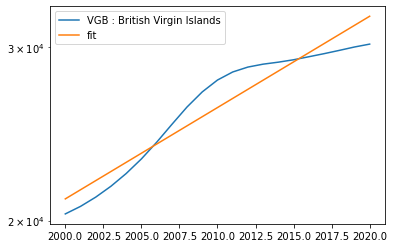

[0.00016801]


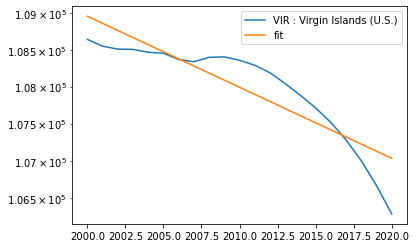

[3.25661358e-05]


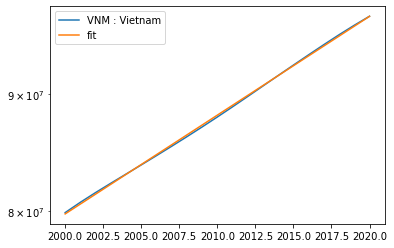

[0.000246]


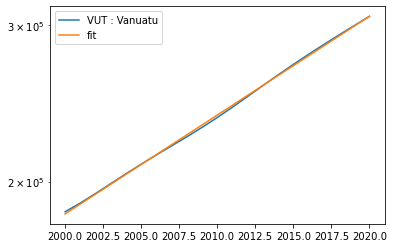

[5.70039826e-05]


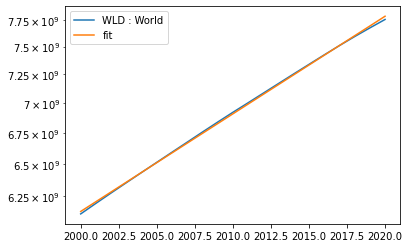

[0.00014245]


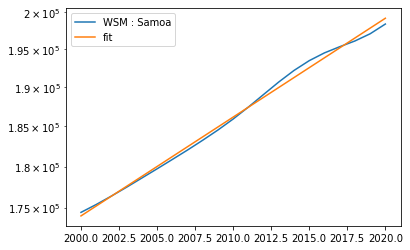

[0.00297872]


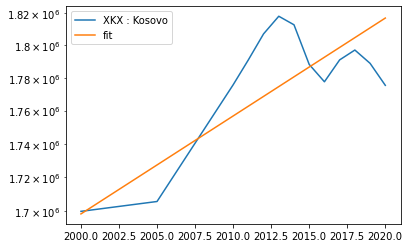

[0.0006518]


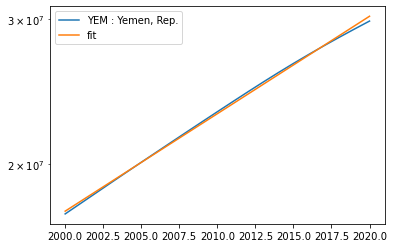

[0.00026058]


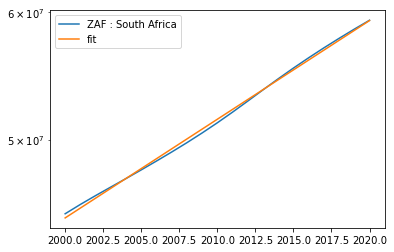

[0.00075236]


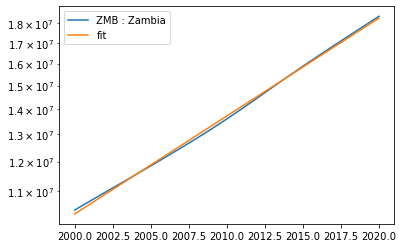

[0.00540345]


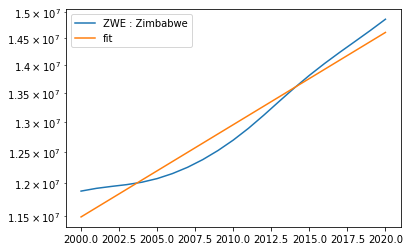

Pass_count total:  260
Pass_count total (%):  99.61685823754789


In [105]:
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

pass_count = 0 
for country in countries[0:261]: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]['value']
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    
    parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)
    if res > 0: # 0.1, < 0 to plot all of them
        y_fit = [fit_funtion(x_i, parameters) for x_i in x] #https://stackoverflow.com/questions/3433486/how-to-do-exponential-and-logarithmic-curve-fitting-in-python-i-found-only-poly
        print(res)
        plt.plot(x,y, label = country + ' : ' + full_name_country)
        plt.plot(x, y_fit, label = 'fit')
        plt.yscale("log")
        plt.legend()
        plt.show()
        pass_count += 1
    
    # https://stackoverflow.com/questions/19189362/getting-the-r-squared-value-using-curve-fit
print('Pass_count total: ', pass_count)
print('Pass_count total (%): ', pass_count*100/len(countries))

## 2. Explore the Exp(t) model last 20 years (Monte Carlo)

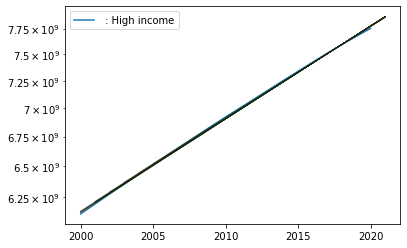

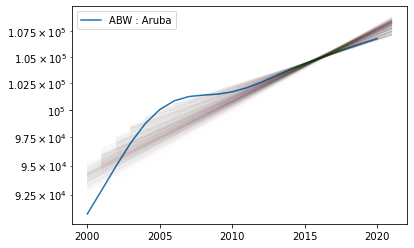

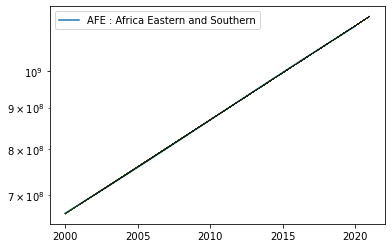

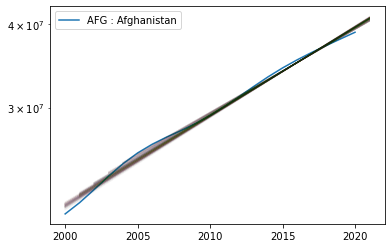

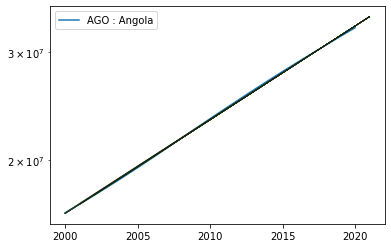

...

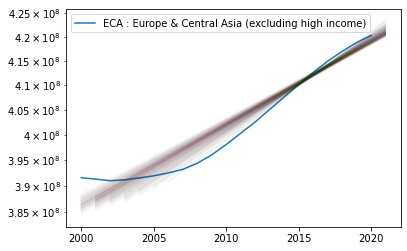

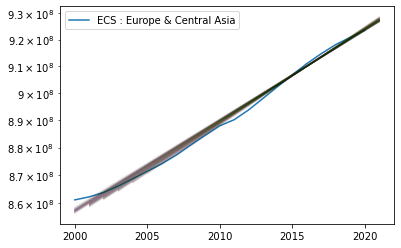

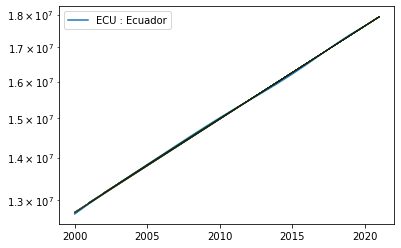

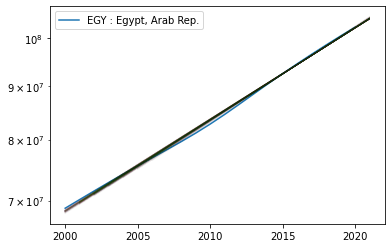

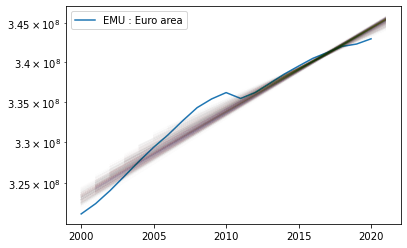

<ipython-input-281-c43d4a5487c4>:21: RuntimeWarning: divide by zero encountered in log
  parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)


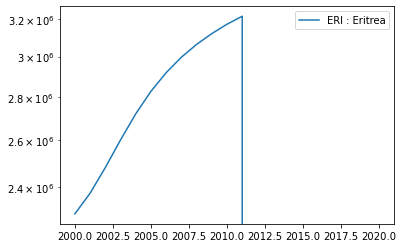

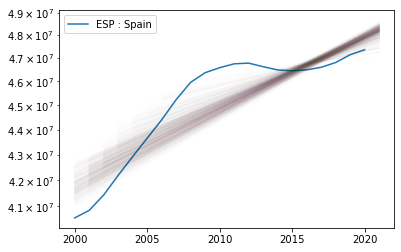

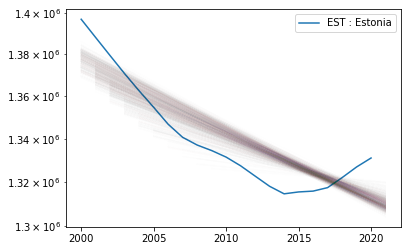

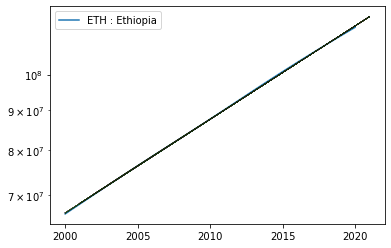

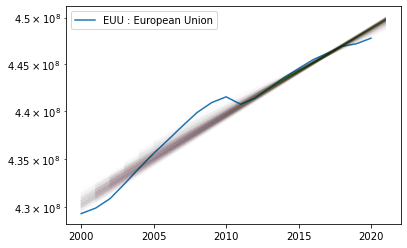

...

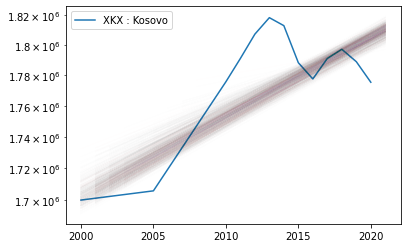

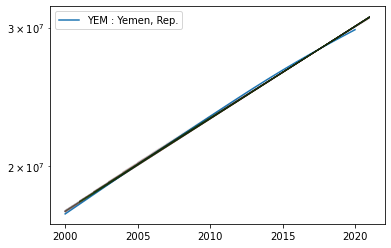

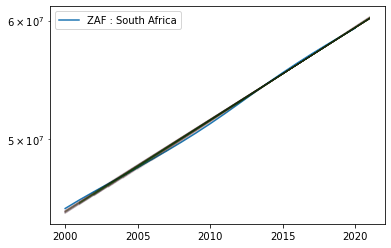

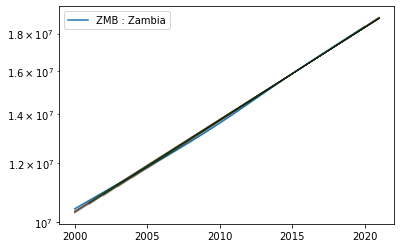

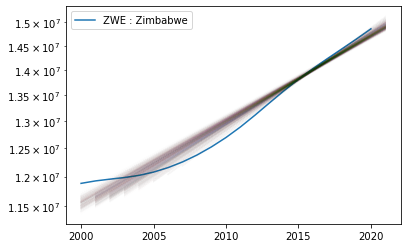

In [281]:
%%time
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

for country in countries: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]['value']
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    plt.plot(x,y, label = country + ' : ' + full_name_country)
    
    total_range = [i for i in range(0,20-2)]
    monteCarloValues  = []
    
    for monteCarlo in range(1000): 
        random_index = np.sort(np.unique(random.sample(total_range,7)+[20, 19, 18, 17, 16]))

        x1 = df_group.loc[country].index.tolist()
        y1 = df_group.loc[country].values.tolist()

        x = [x1[i] for i in random_index]
        y = [y1[i] for i in random_index]
        parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)
        
        x_predict = x + [2021]
        y_fit = [fit_funtion(x_i, parameters) for x_i in x_predict] 
        
        monteCarloValues.append(fit_funtion(2021, parameters))

        plt.plot(x_predict, y_fit, alpha=0.005)
        plt.yscale("log")
    plt.legend()
    plt.show()
        

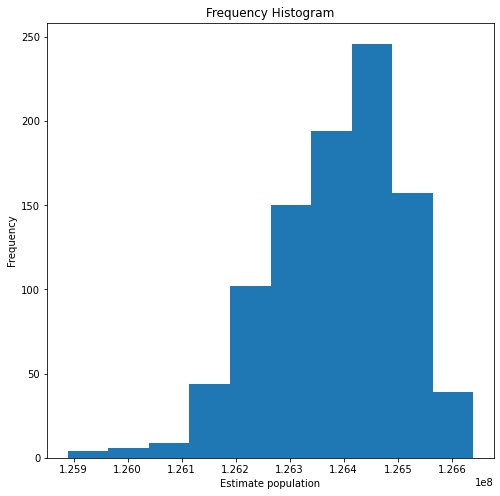

In [280]:
plt.figure(figsize=(8, 8))
plt.hist(monteCarloValues)
plt.gca().set(title='Frequency Histogram', ylabel='Frequency', xlabel = 'Estimate population');

Método simple, seguir con el mismo método para predicir 1 o 4 años no se realizará porque están relacionados. 
Las edades presentan un error y una estimación que se puede calcular utilizando 
np.percentile(monteCarloValues, 25)
np.percentile(monteCarloValues, 75)
tomando los rangos como los porcentiles 25 y 75. 


Se procederá con el cálculo de errores + montecarlo: ¿Cómo cambia los errores con el tiempo? La idea es predecir el error. 

## 3. Método smoth data + adjustment

Predecir por segmentos para calcular la posible corrección: predecir corrección 

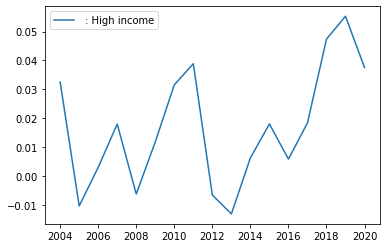

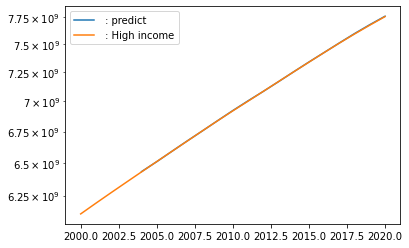

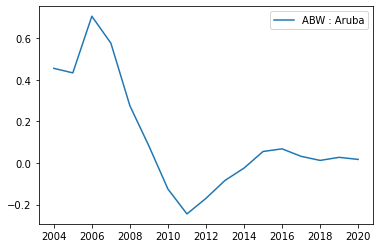

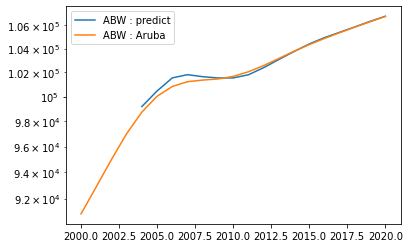

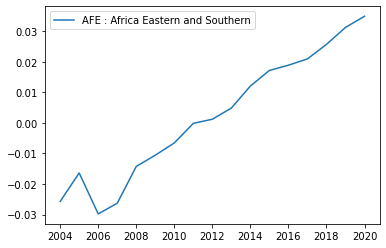

...

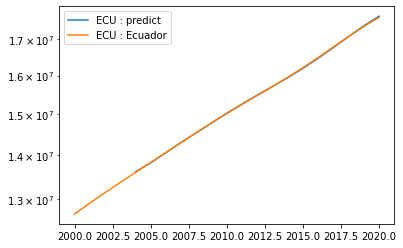

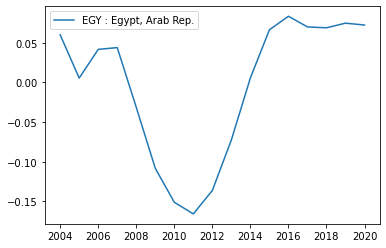

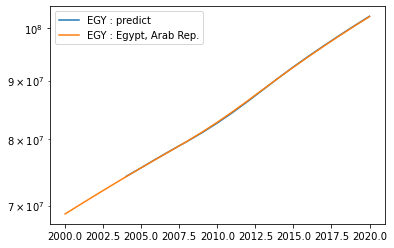

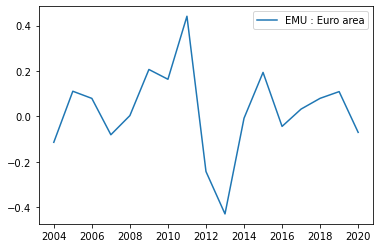

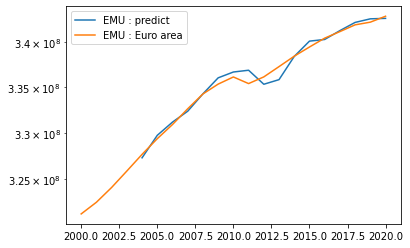

<ipython-input-352-e866f4679cf9>:34: RuntimeWarning: divide by zero encountered in double_scalars
  delta_y_adjustment_normal.append((y_predict-y[j+4])*100/y[j+4])
<ipython-input-352-e866f4679cf9>:17: RuntimeWarning: divide by zero encountered in log
  parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)


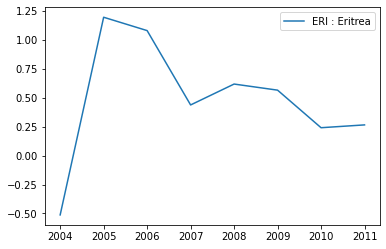

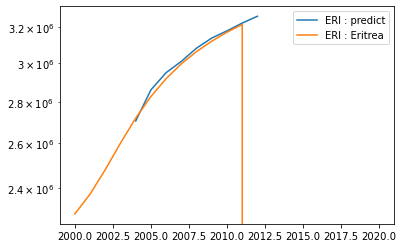

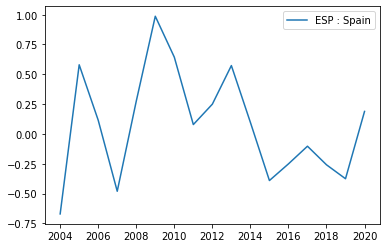

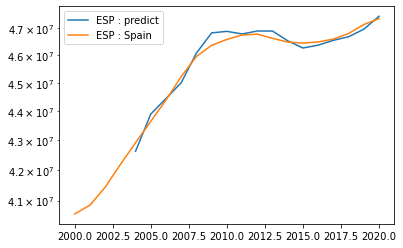

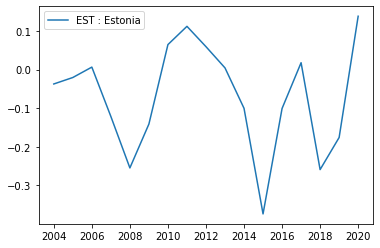

...

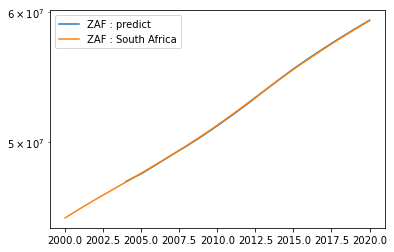

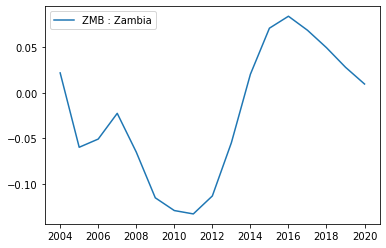

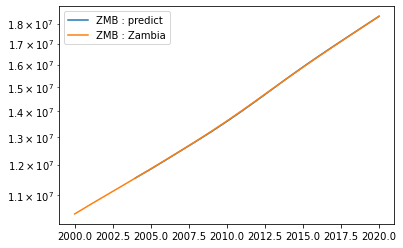

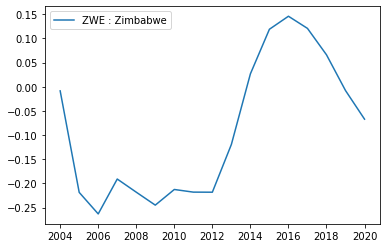

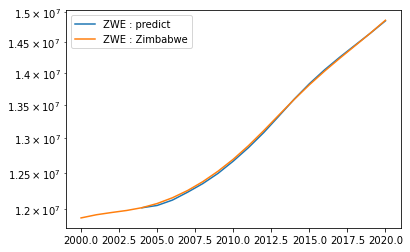

In [352]:
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

for country in countries: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]['value']
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    
    x_adjustment = []
    y_adjustment = []
    delta_y_adjustment = []
    delta_y_adjustment_normal = []
    for j in range(len(x)-4):
        
        x1 = [x[i] for i in range(j,j+4)]
        y1 = [y[i] for i in range(j,j+4)]
        parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)
        
        if len(delta_y_adjustment) >= 2: 
            adjustment = np.mean(delta_y_adjustment[-2:])
        elif len(delta_y_adjustment) == 1: 
            adjustment = delta_y_adjustment[0]
        else: 
            adjustment = 0.1
       
        y_predict = fit_funtion(x[j+4], parameters) - adjustment
        
        # print('x1 values: ', x1)
        # print('ano: ', x[j+4], 'predict: ', y_predict, 'real: ', y[j+4], 'diff: ', y_predict - y[j+4])
        
        x_adjustment.append(x[j+4])
        y_adjustment.append(y_predict)
        delta_y_adjustment.append(y_predict-y[j+4])
        delta_y_adjustment_normal.append((y_predict-y[j+4])*100/y[j+4])
    #print(delta_y_adjustment)
    plt.plot(x_adjustment, delta_y_adjustment_normal, label = country + ' : ' + full_name_country)
    #plt.plot(x, y, label = country + ' : ' + full_name_country)
    #plt.yscale("log")
    plt.legend()
    plt.show()
    
    plt.plot(x_adjustment, y_adjustment, label = country + ' : predict')
    plt.plot(x, y, label = country + ' : ' + full_name_country)
    plt.yscale("log")
    plt.legend()
    plt.show()

## Machine Learning: Inclusion of other variables

In [16]:
# Net migration
# SM.POP.NETM	Net migration
seed = 'http://api.worldbank.org/v2/country/all/indicator/SM.POP.NETM?format=json'
#seed = 'http://api.worldbank.org/v2/country/all/indicator/SH.HIV.0014;SH.DYN.MORT?source=2&format=json'
response_seed = requests.get(seed).json()
df_1 = pd.DataFrame.from_dict(response_seed[1])

In [17]:
%%time
for page in range(2, response_seed[0]['pages']+1): 
#for page in range(2, 50): 
    url = 'http://api.worldbank.org/v2/country/all/indicator/SM.POP.NETM?page='+str(page)+'&format=json'
    response = requests.get(url).json()
    df_1 = df_1.append(pd.DataFrame.from_dict(response[1]), ignore_index=True)
    print(page)

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
27

In [20]:
df_1.to_csv('data/df_1.csv', index=False)

In [18]:
%%time
# SP.DYN.AMRT.MA	Mortality rate, adult, male (per 1,000 male adults): SÍ
seed = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.AMRT.MA?format=json'
#seed = 'http://api.worldbank.org/v2/country/all/indicator/SH.HIV.0014;SH.DYN.MORT?source=2&format=json'
response_seed = requests.get(seed).json()
df_2 = pd.DataFrame.from_dict(response_seed[1])

CPU times: user 11.1 ms, sys: 2.93 ms, total: 14.1 ms
Wall time: 923 ms


In [19]:
%%time
for page in range(2, response_seed[0]['pages']+1): 
#for page in range(2, 50): 
    url = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.AMRT.MA?page='+str(page)+'&format=json'
    response = requests.get(url).json()
    df_2 = df_2.append(pd.DataFrame.from_dict(response[1]), ignore_index=True)
    print(page)

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
27

In [21]:
df_2.to_csv('data/df_2.csv', index=False)

In [22]:
%%time
# SP.DYN.AMRT.FE	Mortality rate, adult, female (per 1,000 female adults)
seed = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.AMRT.FE?format=json'
#seed = 'http://api.worldbank.org/v2/country/all/indicator/SH.HIV.0014;SH.DYN.MORT?source=2&format=json'
response_seed = requests.get(seed).json()
df_3 = pd.DataFrame.from_dict(response_seed[1])

CPU times: user 16.4 ms, sys: 5.13 ms, total: 21.6 ms
Wall time: 1.56 s


In [23]:
%%time
for page in range(2, response_seed[0]['pages']+1): 
#for page in range(2, 50): 
    url = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.AMRT.FE?page='+str(page)+'&format=json'
    response = requests.get(url).json()
    df_3 = df_3.append(pd.DataFrame.from_dict(response[1]), ignore_index=True)
    print(page)

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
27

In [24]:
df_3.to_csv('data/df_3.csv', index=False)

In [28]:
%%time
# SP.DYN.TFRT.IN	Fertility rate, total (births per woman)
seed = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.TFRT.IN?format=json'
#seed = 'http://api.worldbank.org/v2/country/all/indicator/SH.HIV.0014;SH.DYN.MORT?source=2&format=json'
response_seed = requests.get(seed).json()
df_4 = pd.DataFrame.from_dict(response_seed[1])

CPU times: user 18.6 ms, sys: 2.71 ms, total: 21.3 ms
Wall time: 426 ms


In [29]:
%%time
for page in range(2, response_seed[0]['pages']+1): 
#for page in range(2, 50): 
    url = 'http://api.worldbank.org/v2/country/all/indicator/SP.DYN.TFRT.IN?page='+str(page)+'&format=json'
    response = requests.get(url).json()
    df_4 = df_4.append(pd.DataFrame.from_dict(response[1]), ignore_index=True)
    print(page)

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
27

In [30]:
df_4.to_csv('data/df_4.csv', index=False)

In [50]:
df['date'] = df['date'].astype(float)
df_1['date'] = df_1['date'].astype(float)
df_2['date'] = df_2['date'].astype(float)
df_3['date'] = df_3['date'].astype(float)
df_4['date'] = df_4['date'].astype(float)

df_group = df[df['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
df_group_1 = df_1[df_1['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
df_group_2 = df_2[df_2['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
df_group_3 = df_3[df_3['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
df_group_4 = df_4[df_4['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()


In [ ]:
df_group_1.to_csv('data/df_group_1.csv', index=True)
df_group_2.to_csv('data/df_group_2.csv', index=True)
df_group_3.to_csv('data/df_group_3.csv', index=True)
df_group_4.to_csv('data/df_group_4.csv', index=True)

In [51]:
df_all = df_group_1.to_frame().merge(df_group_2.to_frame(), how='outer', 
                            on=['countryiso3code', 'date'], 
                            suffixes=('_1', '_2')
                           ).merge(df_group_3.to_frame(), how='outer', 
                            on=['countryiso3code', 'date']
                                  ).merge(df_group_4.to_frame(), how='outer', 
                                          on=['countryiso3code', 'date'], 
                                          suffixes=('_3', '_4')
                                         ).merge(df_group.to_frame(), how='outer',
                                                 on=['countryiso3code', 'date']
                                                )

In [52]:
countries = df_all.index.get_level_values(0).unique()
print('No. Total countries: ', len(countries))


No. Total countries:  261


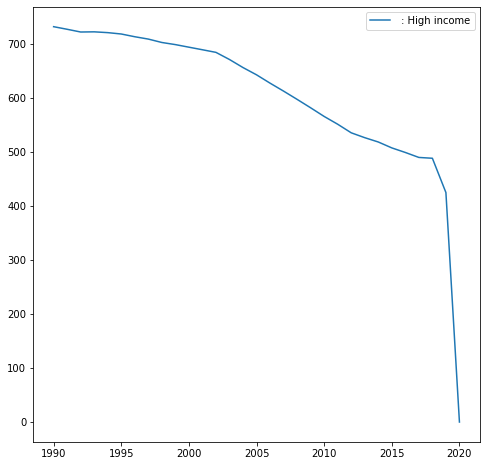

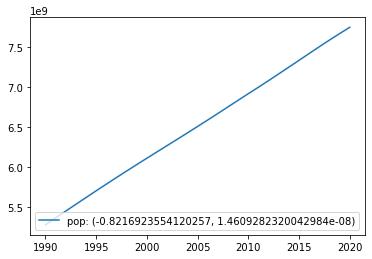

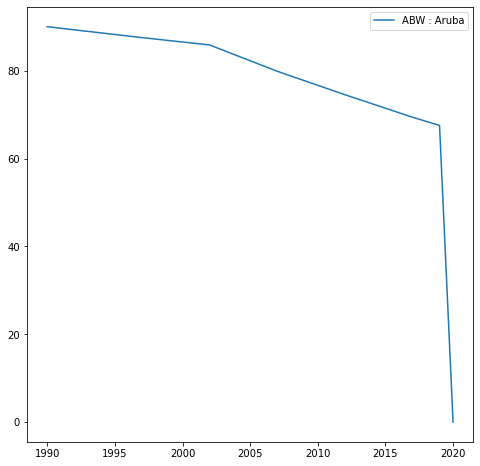

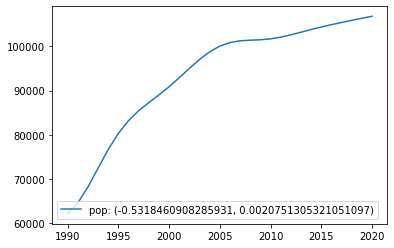

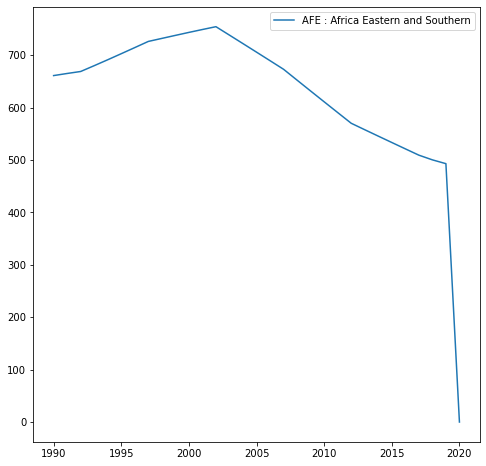

...

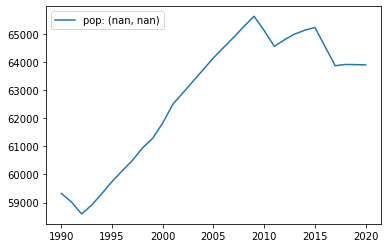

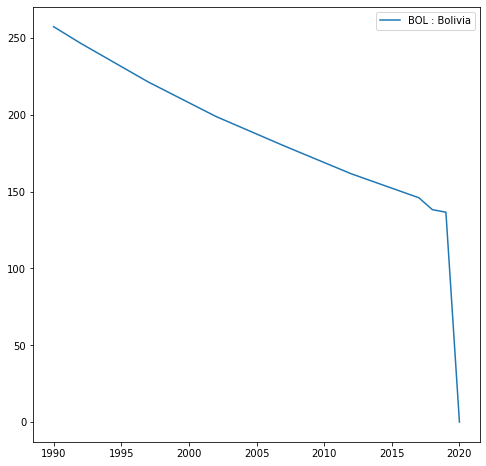

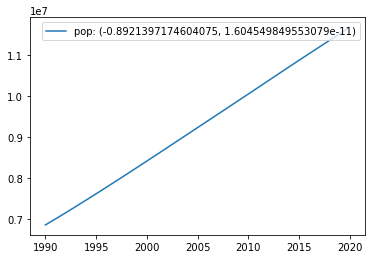

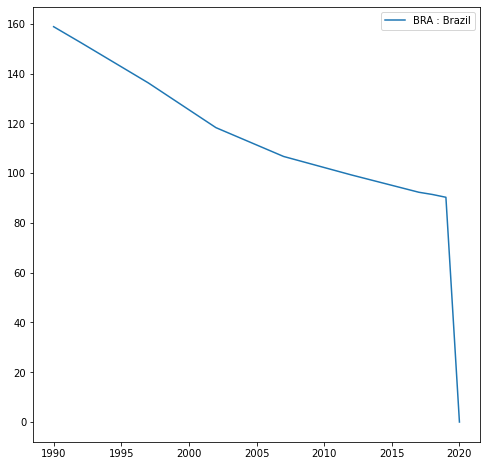

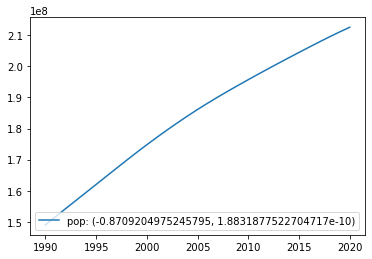

In [99]:

for country in countries[0:30]: 
    plt.figure(figsize=(8, 8))
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]['value']
    x = df_all.loc[country]['value_3'].values.tolist()
    x = df_all.loc[country]['value_3'].index.tolist()
    y = df_all.loc[country]['value_3'].values.tolist()
    y2 = df_all.loc[country]['value'].values.tolist()
    plt.plot(x, y, label = country + ' : ' + full_name_country)
    plt.legend()
    plt.show()
    plt.plot(x, y2, label = 'pop: '+str(pearsonr(y,y2)))
    plt.yscale("linear")
    plt.legend()
    plt.show()

In [91]:
from scipy.stats.stats import pearsonr  
print(pearsonr(y,y2)[0])

-0.8171318583249594


In [66]:
df_all

value_1      value_2     value_3    value_4  \
countryiso3code date                                                   
                1990.0       0.0  1005.108412  731.994436  15.194939   
                1991.0       0.0  1002.865804  727.185230  14.893624   
                1992.0   -7398.0  1001.444807  722.132120  14.602022   
                1993.0       0.0  1004.096112  722.460692  14.313414   
                1994.0       0.0  1003.548479  720.992760  14.077101   
...                          ...          ...         ...        ...   
ZWE             2016.0       0.0   379.617000  319.797000   3.804000   
                2017.0 -584288.0   362.446000  300.101000   3.707000   
                2018.0       0.0   373.207000  337.702000   3.615000   
                2019.0       0.0   369.227000  333.163000   3.531000   
                2020.0       0.0     0.000000    0.000000   0.000000   

                               value  
countryiso3code date                  
                1990.0  5.280046e+09  
                1991.0  5.368139e+09  
                1992.0  5.452576e+09  
                1993.0  5.537886e+09  
                1994.0  5.622086e+09  
...                              ...  
ZWE             2016.0  1.403034e+07  
                2017.0  1.423660e+07  
                2018.0  1.443881e+07  
                2019.0  1.464547e+07  
                2020.0  1.486293e+07  

[8091 rows x 5 columns]

In [ ]:
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()

In [27]:
response_seed[0]['pages']

325